# DLAI 2023/24 Project 12: Bot Playing "Dixit" Board Game

Cristiana Di Tullio, 1803880



**Description of the project**

"Dixit" is a creative board game where players describe images in imaginative ways. In this project I implemented an agent capable of playing Dixit in both the roles of who gives the hint (storyteller) and who guesses (guesser). To reach this purpose I employed a CLIP-like model for multimodal processing together with an LLM to filter and refine the textual outputs. Experiments to assess the model's performance were conducted against GPT-4o multimodal and humans in 15 games.

**Hashtags**: #generative-AI, #multimodal-models

## 1) Introduction

### 1.1) Libraries

In [ ]:
### Import libraries

# General
import os
import random
import requests
import pandas as pd
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.image import imread
from collections import Counter

# CLIP
import requests
from IPython.display import display
from io import BytesIO

# NLP
import nltk
nltk.download('words')
nltk.download('names')
nltk.download('stopwords')
from nltk.corpus import names, stopwords, words # words.fileids() consists of ['en', 'en-basic']
nltk.download('wordnet')
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
import re
from wordcloud import WordCloud

# Transformers
from transformers import AutoProcessor, AutoModel
# more specific libraries are loaded on the fly later

[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Unzipping corpora/words.zip.
[nltk_data] Downloading package names to /root/nltk_data...
[nltk_data]   Unzipping corpora/names.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


In [ ]:
# Auxiliary functions for plotting

def show_card(image_path):
    '''Given a string path, plots the image.'''
    fig = plt.figure()
    img = imread(image_path)
    plt.axis('off')
    plt.imshow(img)
    plt.title(image_path.split('/')[-1])
    plt.show()
    plt.close(fig)
    return


def plot_random_images(folder = ".\cards", n = 4, seed = None):
    '''
    Function to display n images chosen at random from the specified folder.
    '''
    # Open the folder and handle errors
    try:
        image_list = [f for f in os.listdir(folder) if os.path.isfile(os.path.join(folder, f))]
    except FileNotFoundError:
        print(f"[ERROR]: folder '{folder}' not found!")
        return

    if not image_list: # use lists' implicit booleanness
        print(f"[WARNING]: the folder '{folder}' is empty.")
        return
    num_images = min(n, len(image_list))

    if seed:
        random.seed(seed)
    random_images = random.sample(image_list, num_images)

    # Plot
    cols = min(4, n)
    rows = (n + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize = (15, 5))
    axes = axes.flatten()
    for i, ax in enumerate(axes):
        if i < n:
            img_path = os.path.join(folder, random_images[i])
            img = imread(img_path)
            ax.imshow(img)
            ax.set_title(random_images[i])
            ax.axis('off')
        else:
            ax.axis('off')
    fig.suptitle('A sample hand of cards', fontsize = 15)
    plt.tight_layout()
    plt.show()
    return

### 1.2) The Dixit game

Dixit is a French board game first introduced in 2008 based on a set of 84 standard cards illustrated with dream-like scenes. During each turn, one player is designated as the storyteller and comes up with a clue related to one of his cards. Then, he puts his card (covered) at the center of the table and other players do the same with the card from their hand that best matches the storyteller's clue. Then, all the covered cards are shuffled and uncovered at the same time. At this point, each player (storyteller excluded) votes for the image that he/she believes belongs to the storyteller. Finally, points are assigned on the basis of who voted what and players advance on the leaderboard.
There are two key points that make this game interesting:

1. The storyteller's clue should be <u>neither too obvious nor too difficult</u>. In both cases where every player and no player gets the card right, the storyteller will score $0$, so he is incentivated to think of an ambiguous clue that allows some doubts.
2. When the other players add their cards to the table and the cards are uncovered, it might happen that <u>multiple images match the storyteller's clue</u>, some partially, some even more than the original image, introducing another factor of difficulty.

**Note**: for the purpose of this project, I don't implement the whole scoring system and game dynamics simulation, but I provide working demos for the storyteller role and the guesser role.

#### The Dixit Cards

The Dixit cards used in this project are provided by [this Github repository](https://github.com/jminuscula/dixit-online/tree/master/cards). It contains a set of $100$ Dixit cards. two of which appear twice. In the following code cells I proceed to load the cards, remove the duplicates, and visualize some of them.

In [ ]:
%%bash

# Create folder
mkdir -p cards

# Loop over the URLs and download files
for i in {1..100}; do
  num=$(printf "%05d" $i)
  # - Do NOT add spaces before and after "="
  # - %05d ensures number to always contain 5 digits padded with 0
  wget --quiet -P cards "https://raw.githubusercontent.com/jminuscula/dixit-online/refs/heads/master/cards/card_$num.jpg"
done

# Remove duplicates
rm /content/cards/card_00023.jpg
rm /content/cards/card_00044.jpg

echo "done" # can take around 1 min

done


In [ ]:
cards_folder = [os.path.join("/content/cards", path) for path in os.listdir("/content/cards")]
cards_folder.sort()
print("Dixit cards available:", len(cards_folder))

Dixit cards available: 98


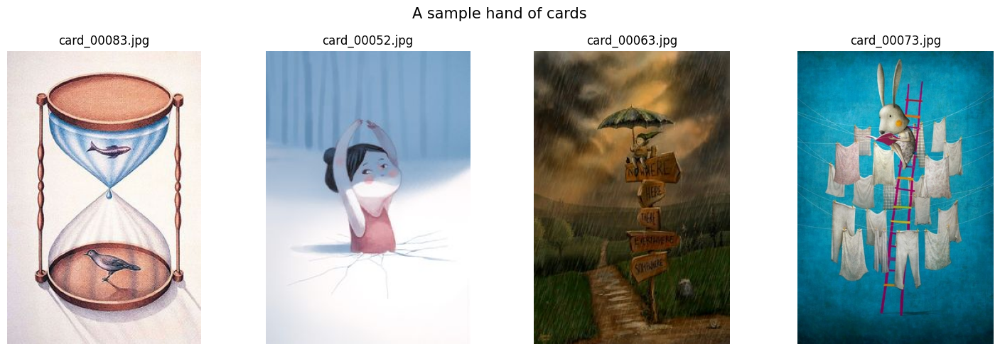

In [ ]:
plot_random_images("/content/cards")

### 1.3) The CLIP model

**CLIP (Contrastive Language-Image Pre-Training)** is a multimodal model trained on a variety of (image, text) pairs from the Internet. By design, it learns to align input image and text in a shared embedding space: it leverages a *contrastive* loss function in the training phase that brings close together the similar pairs of image and text and pushes far apart the dissimilar pairs, where "similar" can be interpreted as "relevant to each other". This way, the model is able to efficiently learn visual concepts.

CLIP's structure looks like this: <br>

<img src = "https://images.ctfassets.net/kftzwdyauwt9/fbc4f633-9ad4-4dc2-3809c22df5e0/0bd2d5abf90d052731538613e4a42668/overview-a.svg" width = 600/>

Text and images pass through two different encoders, specifically a ViT-like transformer to compute visual features and a causal language model to compute textual features. Because of this, the CLIP processor also comes in two parts: the CLIPFeatureExtractor to prepare the images for the image network, and the CLIPTokenizer, which encodes text ready for the language model. Once the input data has been encoded, the model calculates the dot produc of the features and outputs a similarity score tha can be turned into a probability through a *softmax* function.

In conclusion, CLIP can be used for inference to go in both directions between images and tex: we can use it to find the most relevant caption for an image, or vice-versa the most relevant image for a query.

**Remark**: CLIP is <u>not</u> a generative model! <br>
It needs to be fed both visual and textual inputs, then it can compare them.

#### CLIP model loading

I used the CLIP version `openai/clip-vit-base-patch32`, which relies on a ViT-B/32 Transformer architecture as image encoder and a masked self-attention Transformer as a text encoder. A specific method allows to extract both the `logits_per_image` and `logits_per_text` matrices of dot products, that then are fed to a softmax to be turned into probabilities. This has two implications:
- The probability gets distributed on each text caption an image is compared to, and each image a text caption is compared to, decreasing in average at the increase of the number of elements to compare
- No matter how dissimilar an image and a text caption are, their matching probability will never be exactly $0$. Similarly, even if an image and a caption are perfect for each other their probability will never be exactly $1$.

In [ ]:
%%capture
# Installing required packages
#! conda install --yes -c pytorch pytorch=1.7.1 torchvision cudatoolkit=11.0 #cpuonly if running on CPU
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

In [ ]:
import torch
import clip

device = "cuda" if torch.cuda.is_available() else "cpu"
clip_model, clip_preprocess = clip.load("ViT-B/32", device = device)
print("device =", device)

device = cuda


In [ ]:
# List all the CLIP available models
clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

#### CLIP demo Image-to-Text

In this section I explore the Image-to-Text matching capabilities of the base CLIP model with a sample image and some simple captions. Please, meet my cat Ipa.

In [ ]:
Ipa_path = "https://raw.githubusercontent.com/laacri/DLAI-MultimodalDixitBot/refs/heads/main/Ipa.jpg"
Ipa_image = Image.open(requests.get(Ipa_path, stream = True).raw)

Input image:



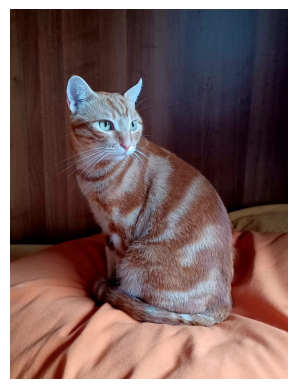


Sample labels: ['a dog', 'a cat', 'a turtle', 'a bird', 'a rabbit']

Label probs: [[0.00963724 0.96125025 0.00261977 0.00573432 0.02075837]]


In [ ]:
# Input data
print("Input image:\n")
fig = plt.figure()
plt.imshow(Ipa_image)
plt.axis('off')
plt.show()
plt.close(fig)

captions = ["a dog", "a cat", "a turtle", "a bird", "a rabbit"]

# Preprocessing inputs
image = clip_preprocess(Ipa_image).unsqueeze(0).to(device)
text = clip.tokenize(captions).to(device)

# Image-to-Text inference with CLIP
with torch.no_grad():
    # Encoding image and text with the respective CLIP encoders
    image_features = clip_model.encode_image(image)
    text_features = clip_model.encode_text(text)

    # Calculate logit scores (cosine similarity x 100)
    logits_per_image, logits_per_text = clip_model(image, text)
    # - logits_per_image: matrix whose rows contain the logits of an image vs all the text snippets in the batch
    # - logits_per_text: matrix whose rows contain the logits of a text snippet vs all the images in the batch

    # Calculate probabilities for the input image via softmax on raw logits_per_image
    probs = logits_per_image.softmax(dim = -1).cpu().numpy()
    # This ensures that
    # - the probabilities for each row (each image) sum up to 1
    # - higher logit scores correspond to higher matching probabilities

# Print output
print("\nSample labels:", captions)
print("\nLabel probs:", probs)

#### CLIP demo Text-to-Image

In this section I explore the Text-to-Image matching capabilities of the base CLIP model with a fixed text caption and some sample images.

Input text query: "an image of a cute cat"

Sample images:



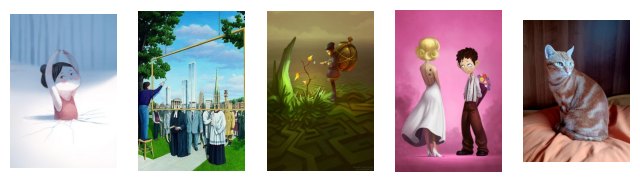


Image probs: [[0.03608944 0.00003041 0.00120589 0.00021525 0.962459  ]]


In [ ]:
# Set seed for reproducibility
random.seed(0)

# Build set of sample images containing Ipa's and randomly selected Dixit cards
image_list = random.sample(cards_folder, 4) #4
random.shuffle(image_list)
text_query = "an image of a cute cat"
print("Input text query:", '"' + text_query + '"')

# Preprocessing inputs
images = torch.cat([clip_preprocess(Image.open(img)).unsqueeze(0).to(device) for img in image_list] + [clip_preprocess(Ipa_image).unsqueeze(0).to(device)])
text = clip.tokenize([text_query]).to(device)

# Text-to-Image Inference with CLIP
with torch.no_grad():
    image_features = clip_model.encode_image(images)
    text_features = clip_model.encode_text(text)

    # Calculate probabilities for the input caption via softmax on raw logits_per_text
    logits_per_image, logits_per_text = clip_model(images, text)
    probs = logits_per_text.softmax(dim=-1).to(device).cpu().numpy()

# Showing outputs
print("\nSample images:\n")
images_to_plot = [Image.open(img) for img in image_list] + [Ipa_image]
fig, axes = plt.subplots(1, len(images_to_plot), figsize = (8, 5)) #, figsize = (15, 5) with 5 images
for ax, img in zip(axes, images_to_plot):
    #im = imread(img)
    ax.imshow(img)
    ax.axis('off')
#plt.savefig("text_to_image_example.png")
plt.show()

np.set_printoptions(suppress = True) #suppress scientific notation
print("\nImage probs:", probs)

#### Further CLIP experiments

Here I run more experiments to test the basic functionality of CLIP on some of the Dixit images and custom captions.

In [ ]:
def run_clip_demo(image_path, labels):
    '''
    Function used to run some preliminary tests of the CLIP model.
    Task: Image -> Text
    - image is the input image path
    - labels is a list of captions to compare the image with
    '''
    image = clip_preprocess(Image.open(image_path)).unsqueeze(0).to(device)
    text = clip.tokenize(labels).to(device)

    with torch.no_grad():
        image_features = clip_model.encode_image(image)
        text_features = clip_model.encode_text(text)

        logits_per_image, logits_per_text = clip_model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("Label probs:", probs)
    return

Tests:

In [ ]:
sample_labels = ["a boat", "water", "a dog", "a cat", "a boy", "a girl", "a fish"]

Input image:



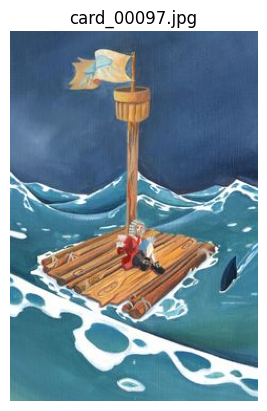


Candidate labels: ['a boat', 'water', 'a dog', 'a cat', 'a boy', 'a girl', 'a fish'] 

Label probs: [[9.858e-01 9.369e-03 3.688e-04 1.179e-04 9.718e-04 5.450e-04 2.947e-03]]


In [ ]:
# Test 1
img_path = "/content/cards/card_00097.jpg"

print("Input image:\n")
show_card(img_path)
print("\nCandidate labels:", sample_labels, "\n")
run_clip_demo(img_path, sample_labels)

Input image:



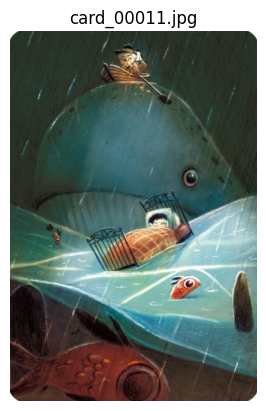


Candidate labels: ['a boat', 'water', 'a dog', 'a cat', 'a boy', 'a girl', 'a fish'] 

Label probs: [[0.2346    0.007313  0.002264  0.004646  0.004433  0.0009007 0.7456   ]]


In [ ]:
# Test 2
img_path = "/content/cards/card_00011.jpg"

print("Input image:\n")
show_card(img_path)
print("\nCandidate labels:", sample_labels, "\n")
run_clip_demo(img_path, sample_labels)

Input image:


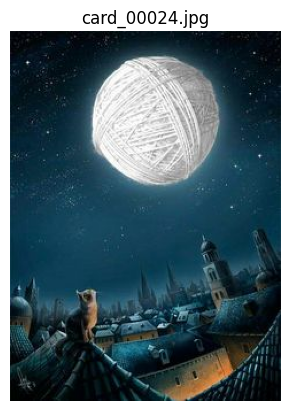


Candidate labels: ['a boat', 'water', 'a dog', 'a cat', 'a boy', 'a girl', 'a fish'] 

Label probs: [[0.02565  0.0125   0.01289  0.9326   0.002832 0.001317 0.012115]]


In [ ]:
# Test 3
img_path = "/content/cards/card_00024.jpg"

print("Input image:")
show_card(img_path)
print("\nCandidate labels:", sample_labels, "\n")
run_clip_demo(img_path, sample_labels)

Input image:


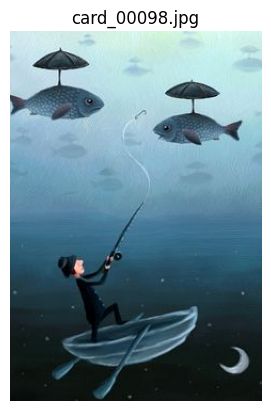


Candidate labels: ['a boat', 'water', 'a dog', 'a cat', 'a boy', 'a girl', 'a fish'] 

Label probs: [[0.0818    0.0627    0.0008807 0.001386  0.01056   0.003593  0.839    ]]


In [ ]:
# Test 4
img_path = "/content/cards/card_00098.jpg"

print("Input image:")
show_card(img_path)
print("\nCandidate labels:", sample_labels, "\n")
run_clip_demo(img_path, sample_labels)

Input image:



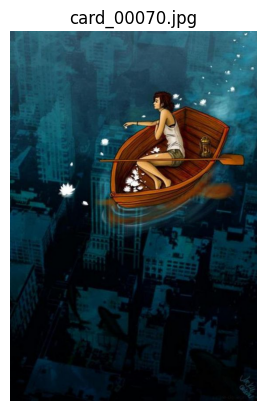


Candidate labels: ['a boat', 'water', 'a dog', 'a cat', 'a boy', 'a girl', 'a fish'] 

Label probs: [[0.6777  0.1056  0.00827 0.0157  0.04614 0.0889  0.0574 ]]


In [ ]:
# Test 5
img_path = "/content/cards/card_00070.jpg"

print("Input image:\n")
show_card(img_path)
print("\nCandidate labels:", sample_labels, "\n")
run_clip_demo(img_path, sample_labels)

#### Zero-Shot Classification with CIFAR10 and CIFAR-100 labels

In this section, I experiment with the Zero-Shot capabilities of the base CLIP model with two sets of labels taken from the CIFAR10 and CIFAR100 datasets classes respectively. At inference, these label sets are passed to the model to output the top $5$ classes ranked by their matching probability.

A scheme of the CLIP Zero-Shot case use is depicted below:

<img src = "https://images.ctfassets.net/kftzwdyauwt9/d9d46e4b-6d6a-4f9e-59a242ea1441/c7b386880f1af005fd02f159de7f4d00/overview-b.svg" width = 600/>

100%|██████████| 170M/170M [00:19<00:00, 8.88MB/s]


Extracting /root/.cache/cifar-10-python.tar.gz to /root/.cache


100%|██████████| 169M/169M [00:12<00:00, 13.3MB/s]


Extracting /root/.cache/cifar-100-python.tar.gz to /root/.cache

Input image:



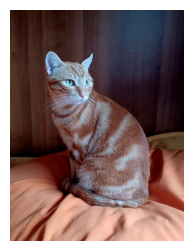


Top 5 predictions with CIFAR10 labels:

             cat: 98.68%
             dog: 0.74%
            deer: 0.23%
            bird: 0.14%
           horse: 0.10%

Top 5 predictions with CIFAR100 labels:

    sweet_pepper: 38.18%
          orange: 18.31%
           tiger: 14.72%
             boy: 6.13%
            girl: 3.66%


In [ ]:
from torchvision.datasets import CIFAR100, CIFAR10

# Prepare the inputs
cifar10 = CIFAR10(root = os.path.expanduser("~/.cache"), download = True, train = False)
cifar100 = CIFAR100(root = os.path.expanduser("~/.cache"), download = True, train = False)

print("\nInput image:\n")
plt.figure(figsize = (3, 3))
plt.imshow(Ipa_image)
plt.axis('off')
plt.show()

# Preprocessing inputs
image_input = clip_preprocess(Ipa_image).unsqueeze(0).to(device)
text_inputs_C10 = torch.cat([clip.tokenize(f"a photo of a {c}") for c in cifar10.classes]).to(device)
text_inputs_C100 = torch.cat([clip.tokenize(f"a photo of a {c}") for c in cifar100.classes]).to(device)

# Calculate features
with torch.no_grad():
    image_features = clip_model.encode_image(image_input)
    text_features_C10 = clip_model.encode_text(text_inputs_C10)
    text_features_C100 = clip_model.encode_text(text_inputs_C100)

# Pick the top 5 most similar labels for the image
image_features /= image_features.norm(dim = -1, keepdim = True)
text_features_C10 /= text_features_C10.norm(dim = -1, keepdim = True)
text_features_C100 /= text_features_C100.norm(dim = -1, keepdim = True)
similarity_C10 = (100.0 * image_features @ text_features_C10.T).softmax(dim = -1)
similarity_C100 = (100.0 * image_features @ text_features_C100.T).softmax(dim = -1)

k = 5
values_C10, indices_C10 = similarity_C10[0].topk(k)
values_C100, indices_C100 = similarity_C100[0].topk(k)

# Print the result
print(f"\nTop {k} predictions with CIFAR10 labels:\n")
for value, index in zip(values_C10, indices_C10):
    print(f"{cifar10.classes[index]:>16s}: {100 * value.item():.2f}%")

print(f"\nTop {k} predictions with CIFAR100 labels:\n")
for value, index in zip(values_C100, indices_C100):
    print(f"{cifar100.classes[index]:>16s}: {100 * value.item():.2f}%")

- In both cases, we can see that the retrieved classes make somehow sense with the content of the image. The CIFAR 10 case is perfectly in line with our expectations. After all, it just contains $10$ class labels. The CIFAR 100 case is a bit weirder: the most relevant class for the input image appears to be "sweet pepper".

- Curiously, it turns out the CIFAR100 dataset doesn't contain "cat" among its labels.

- The key takeaway from this is that a big part of, if not the entire experiment, <u>depends on the set of text inputs</u> that the image is being confronted to!

## 2.) Building a text corpus: is an image worth just 1000 words?

To implement my agent, I am going to need a suitable text corpus containing enough and enough relevant keywords to describe the content of a Dixit card. I start downloading the set of words contained in the NLTK "English-Basic" set. Then, I proceed adding the class labels from the CIFAR 10 and CIFAR 100 datasets, but the most important addition are the keywords extracted from the decriptions of a dataset of paintings, like explained below. At the end, I gather a vocabulary of around $1000$ words that will be used both by the storyteller and the guesser to play.

In [ ]:
from torchvision.datasets import CIFAR100, CIFAR10

# Prepare the inputs
cifar10 = CIFAR10(root = os.path.expanduser("~/.cache"), download = True, train = False)
cifar100 = CIFAR100(root = os.path.expanduser("~/.cache"), download = True, train = False)

100%|██████████| 170M/170M [00:11<00:00, 14.6MB/s]


Extracting /root/.cache/cifar-10-python.tar.gz to /root/.cache


100%|██████████| 169M/169M [00:11<00:00, 15.1MB/s]


Extracting /root/.cache/cifar-100-python.tar.gz to /root/.cache


In [ ]:
print("\n" + "=" * 50 + "\n")
print("Creating a text corpus.")
print("\n" + "=" * 50 + "\n")

print("--- The EN-BASIC text corpus ---")
words_en_basic = words.words('en-basic')
print("Size of the corpus:\n", len(words_en_basic))
print("Random sample of words:")
random.sample(words_en_basic, 10)

print("\n--- Adding the CIFAR10 and CIFAR100 classes ---")
vocabulary = sorted(set(words_en_basic + cifar10.classes + cifar100.classes))
print("Size of the vocabulary:\n", len(vocabulary))
print("Random sample of words:")
random.sample(vocabulary, 10)



Creating a text corpus.


--- The EN-BASIC text corpus ---
Size of the corpus:
 850
Random sample of words:

--- Adding the CIFAR10 and CIFAR100 classes ---
Size of the vocabulary:
 931
Random sample of words:


['mark',
 'frame',
 'dry',
 'seal',
 'paste',
 'soup',
 'fall',
 'oil',
 'station',
 'summer']

We have a rudimentary vocabulary to start from. However, it still lacks several basic concepts that can be important in relation to the Dixit cards, like "candle", "piano", "dance", "hill" and quite some more.

Therefore, we integrate this vocabulary with a selection of words derived from a dataset of paintings with short descriptions publicly available on [Kaggle](https://www.kaggle.com/datasets/downshift/russian-classic-painting-dataset?select=description.csv). The reason for searching words in such a specific context is that we are looking for a corpus that can aptly describe a scene, possibly abstract, possibly surreal, just like a painting can be. So, textual descriptions of paintings would be a great place to start from. Unfortunately, not many datasets have proved ideal for this task: some had way too generic subject descriptions (e.g. "Still-Life", "Portrait", "Landscape Art"), while using directly the titles of artworks introduces a lot of noise in terms of first names (e.g. "Portrait Oberleutnant Theodor Von Klein", "Thetis Bringing the Armor to Achilles", "Isabella Stewart Gardner in Venice") and geographical locations (e.g. "A River Landscape, Westphalia", "Lilacs at Maurecourt", "A Cowherd at Valhermeil, Auvers-sur-Oise") which is impossible to filter out manually. Anyway, the presented dataset represents a good trade-off to enrich our vocabulary with concepts of interest. Below we proceed to download and preprocess it.

In [ ]:
!pip -q install -U kagglehub

In [ ]:
# Directly use kagglehub api
import kagglehub

# Download latest version
path = kagglehub.dataset_download("downshift/russian-classic-painting-dataset")
print("Path to dataset files:", path)

# Load dataset in a pandas dataframe
paint_df = pd.read_csv(os.path.join(path, "description.csv"))

# Extract painting's description
filtered_df = paint_df[paint_df['gpt_description'].str.startswith(('a painting of', 'a drawing of'), na = False)]
print("\nSample descriptions:\n")
print(filtered_df.gpt_description)

# Remove stopwords

stop_words = set(stopwords.words('english'))
def remove_stopwords(desc):
    '''Function to remove stopwords from each description string.'''
    words = re.findall(r'\b\w+\b', desc)  # equivalent to desc.split()
    keywords = [word for word in words if word not in stop_words]
    return keywords

print("\n--- Removing stopwords ---")
# Get list of description strings
descriptions = [desc.lower() for desc in filtered_df['gpt_description'].tolist()]
# Get a cleaned version of vocabulary
tokenized_descriptions = [remove_stopwords(desc) for desc in descriptions] # list of lists

100%|██████████| 175M/175M [00:08<00:00, 20.6MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/downshift/russian-classic-painting-dataset/versions/1

Sample descriptions:

0                       a painting of a river in the fall
1       a painting of a field with a barn in the backg...
2                        a painting of a deer in the snow
3       a painting of a snowy scene with a house and a...
4        a painting of a green field with trees and water
                              ...                        
1664           a painting of a man in a blue coat and hat
1666      a painting of a man in a green coat and red hat
1667                      a drawing of a woman with a hat
1668         a drawing of a group of people on horsebacks
1669      a painting of a man with a bird on his shoulder
Name: gpt_description, Length: 1524, dtype: object

--- Removing stopwords ---


Let's have a look at the words the dataset provides us with:

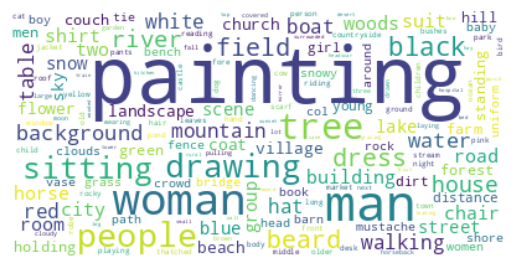

In [ ]:
%matplotlib inline

# Flatten the list of lists into single list
descriptions_corpus = [word for sublist in tokenized_descriptions for word in sublist]

# Plot wordcloud
description_text = ' '.join(descriptions_corpus)

word_cloud = WordCloud(collocations = False, background_color = 'white').generate(description_text)
plt.imshow(word_cloud, interpolation = 'bilinear')
plt.axis("off")
#plt.savefig("wordcloud.png")
plt.show()

Complete the preprocessing:

In [ ]:
# Extract keywords
descriptions_word_frequency = Counter(descriptions_corpus) # Counter object with word: frequency entries
description_keywords = list(descriptions_word_frequency.keys())

# Integrating vocabulary with other fundamental concepts
numbers = ["one", "two", "three", "four", "five", "six", "seven", "eight", "nine", "ten"]
colors = ["red", "blue", "green", "yellow", "orange", "purple", "pink", "brown", "black", "white", "gray"]
fantasy_terms = ["dream", "wish", "magic", "fairy", "wizard", "witch", "unicorn", "mermaid"]
medioeval_terms = ["dragon", "knight", "castle", "tower", "crown", "chess"]
art_terms = ["poetry", "paint", "sculpture", "music", "mask"]
fruit_terms = ["banana", "watermelon", "pineapple", "mango", "carrot", "tomato"]

vocabulary += description_keywords
vocabulary += numbers + colors + fantasy_terms + medioeval_terms + art_terms + fruit_terms
print("Original vocabulary length:")
print(len(vocabulary), "\n")

# Perform lemmatization to resolve singular/plural and verbal tense redundancy

# Removing stopwords
vocabulary = [word for word in vocabulary if word not in stop_words]
print("Vocabulary length after removing stopwords:")
print(len(vocabulary))


# Initialize lemmatizer
lemmatizer = WordNetLemmatizer()

vocabulary_lemmatized = sorted(set([lemmatizer.lemmatize(word) for word in vocabulary]))
print("\nVocabulary length after lemmatization:")
print(len(vocabulary_lemmatized))


# Filter out other unwanted words
other_words = ["among", 'account', "lawn_mower", "lils", "aw", "bit", "chin", "col",
               "condition", "agreement", "crashing", "daughter", "son", "brother", "sister",
               "quite", "pling", "advertisement", "covered", "apparatus", "opposite", "till",
               "probable", "fixed", "sort", "unit", "general"]
pronouns = ["I", "me", "we", "us", "you", "he", "him", "she", "her", "it", "they", "them",
            "who", "whom", "whose", "what", "which", "where", "when", "why", "how",
            "who", "whom", "whose", "which", "that", "this", "that", "these", "those"]

words_to_exclude = other_words + pronouns

vocabulary_filtered = [word for word in vocabulary_lemmatized if word not in words_to_exclude]
print("\nVocabulary length after removing other unwanted words:")
print(len(vocabulary_filtered))


# Handling synonyms and verbal forms ending in -ing
synonym_map = {
    'snowy': 'snow',
    'aquarium_fish': 'fish',
    'flatfish': 'fish',
    'flying': 'fly',
    'trout': 'fish',
    'maple_tree': 'tree',
    'oak_tree': 'tree',
    'palm_tree': 'tree',
    'pine_tree': 'tree',
    'birch': 'tree',
    'pickup_truck': 'truck',
    'sweet_pepper': 'pepper',
    'rocky': 'rock',
    'seashore': 'shore',
    'countryside': 'country',
    'sticky': 'stick',
    'rest': 'sleep',
    'harbour': 'harbor'
    }


def add_ing_to_synonyms(corpus, synonym_map):

    for word in corpus:
        if word.endswith("ing"):
            base_word = lemmatizer.lemmatize(word, "v")  # "v" says we are looking for verb forms
            # If the base word is not in the corpus, keep it as it is
            # If it is, reduce the -ing form to it
            if base_word in corpus:
                if word not in synonym_map.keys():
                    synonym_map[word] = base_word

    return synonym_map

synonym_map = add_ing_to_synonyms(vocabulary_lemmatized, synonym_map)

# Apply synonym mapping
vocabulary_unified = [synonym_map.get(word, word) for word in vocabulary_filtered]
vocabulary_unified = sorted(set(vocabulary_unified))
print("\nVocabulary length after handling synonyms:")
print(len(vocabulary_unified))

# Visualize some words
print("\nRandom sample of words from the vocabulary:")
random.sample(vocabulary_unified, 20)

Original vocabulary length:
3845 

Vocabulary length after removing stopwords:
3845

Vocabulary length after lemmatization:
1118

Vocabulary length after removing other unwanted words:
1090

Vocabulary length after handling synonyms:
1061

Random sample of words from the vocabulary:


['move',
 'archway',
 'wardrobe',
 'witch',
 'four',
 'band',
 'unicorn',
 'self',
 'log',
 'fern',
 'dragon',
 'spoon',
 'short',
 'weather',
 'drain',
 'book',
 'poetry',
 'vessel',
 'person',
 'angry']

Let's see what are now the top 10 retrieved keywords for our sample image:

Input image:



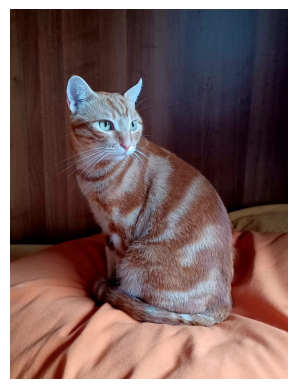


Top predictions:

             cat: 13.68%
         striped: 5.98%
            pose: 2.20%
          copper: 2.07%
           brown: 1.85%
          orange: 1.71%
         sitting: 1.56%
           tiger: 1.38%
             fat: 1.35%
            tail: 1.21%


In [ ]:
# Input image
print("Input image:\n")
fig = plt.figure()
plt.imshow(Ipa_image)
plt.axis('off')
plt.show()
plt.close(fig)

# Preprocessing
image_input = clip_preprocess(Ipa_image).unsqueeze(0).to(device)
text_inputs = torch.cat([clip.tokenize(f"a photo of a {c}") for c in vocabulary_unified]).to(device) #cifar100.classes

# Calculate features
with torch.no_grad():
    image_features = clip_model.encode_image(image_input)
    text_features = clip_model.encode_text(text_inputs)

# Pick the top 5 most similar labels for the image
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

k = 10
values, indices = similarity[0].topk(k)

# Print the result
print("\nTop predictions:\n")
for value, index in zip(values, indices):
    print(f"{vocabulary_unified[index]:>16s}: {100 * value.item():.2f}%")

Apart from insinuating that my cat is fat, we can see that all the top $10$ model predictions are more or less relevant to the image it was given. Definitely an improvement in conceptual alignment with respect to using the CIFAR 100 dataset classes.

## 3) SigLIP: a SOTA CLIP model

After some literature review, I was able to identify **SigLIP (Sigmoid Loss for Language Image Pre-Training)** as a state-of-the-art (SOTA) CLIP-like model. Instead of the classic contrastive learning approach with softmax normalization, the authors propone a simple pairwise sigmoid loss to replace the loss function used in the original CLIP. According to their paper, the sigmoid function operates on the single image-text pairs and does not require a global view of the pairwise similarities for normalization. This results in better performance in Zero-Shot classification accuracy on ImageNet, in addition to a better scaling-up capability of the batch size. The model can be used in a very similar way to CLIP, but there are two things to keep in mind:
- We need to <u>apply the sigmoid activation function</u> to the logits, instead of the softmax;
- As a consequence, <u>the output probabilities need to be interpreted differently</u>: we are no more in the softmax settings, where the probabilities sum up to $1$. Now we need to look at them independently, and normally they are a lot flatter compared to CLIP. Good matches are retrieved even at a very low probabilty.

Below we proceed to load the model version `google/siglip-base-patch16-224`:

In [ ]:
# Loading the SigLIP model
device = "cuda" if torch.cuda.is_available() else "cpu"
siglip_model = AutoModel.from_pretrained("google/siglip-base-patch16-224")
siglip_processor = AutoProcessor.from_pretrained("google/siglip-base-patch16-224")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Define functions to perform inference in both Image-to-Text and Text-to-Image directions:

In [ ]:
def siglip_inference_image_to_text(model, processor, input_image, input_vocabulary):
    '''
    Function to run SigLIP on an input image against a number of text captions.
    Variables involved:
    - input_image has to be a PIL Image object
    - input_vocabulary is a list of textual elements (words/captions)
    - results is a list of tuples (tensor, text) for each text snippet in vocabulary
    '''
    #texts = [f'This is a photo of {label}.' for label in vocabulary_unified]
    # important: we pass `padding=max_length` since the model was trained with this
    inputs = processor(text = input_vocabulary, images = input_image,
                       padding = "max_length", return_tensors = "pt")

    with torch.no_grad():
        outputs = model(**inputs)

    logits_per_image = outputs.logits_per_image
    probs = torch.sigmoid(logits_per_image) # these are the probabilities

    results = [r for r in zip(probs[0], input_vocabulary)] # match probability with text
    results = sorted(results, key = lambda x: x[0].item(), reverse = True) # rank in decreasing prob value

    return results


def siglip_inference_text_to_image(model, processor, input_images, input_text):
    '''
    Function to run SigLIP on an input image against a number of text captions.
    Variables involved:
    - input_images has to be list of image paths in string form
    - input_text is a single text string
    - results is a list of tuples (tensor, image_path) for each image snippet in input list
    '''
    images = [Image.open(img) for img in input_images]
    # important: we pass `padding=max_length` since the model was trained with this
    inputs = processor(text = input_text, images = images,
                       padding = "max_length", return_tensors = "pt")

    with torch.no_grad():
        outputs = model(**inputs)

    logits_per_text = outputs.logits_per_text
    probs = torch.sigmoid(logits_per_text) # these are the probabilities

    #torch.set_printoptions(sci_mode = False) # disable scientific notation for print
    results = [r for r in zip(probs[0], input_images)] # match probability with image
    results = sorted(results, key = lambda x: x[0].item(), reverse = True) # rank in decreasing prob value

    return results

### SigLIP demo

Testing with image:



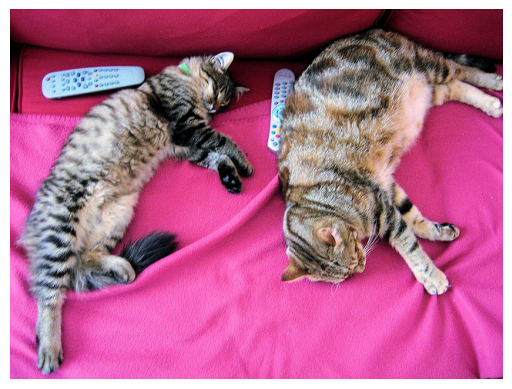


Top 10 retrieved keywords:
CPU times: user 2min 2s, sys: 28.9 s, total: 2min 31s
Wall time: 3min 7s


[(tensor(0.0204), 'laying'),
 (tensor(0.0084), 'animal'),
 (tensor(0.0060), 'sleep'),
 (tensor(0.0051), 'cat'),
 (tensor(0.0023), 'couch'),
 (tensor(0.0006), 'comfort'),
 (tensor(0.0004), 'tired'),
 (tensor(0.0003), 'outstretched'),
 (tensor(0.0003), 'striped'),
 (tensor(0.0002), 'pink')]

In [ ]:
%%time
# Run test with SigLIP sample image
url = 'http://images.cocodataset.org/val2017/000000039769.jpg' # image with 2 cats
sample_image = Image.open(requests.get(url, stream = True).raw)
print("Testing with image:\n")
plt.imshow(sample_image)
plt.axis("off")
plt.show()

results = siglip_inference_image_to_text(siglip_model, siglip_processor,
                                         sample_image, vocabulary_unified)
print("\nTop 10 retrieved keywords:")
results[:10]


Testing with image:



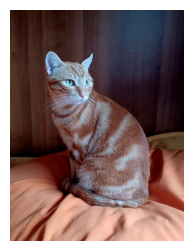


Top 10 retrieved keywords:
CPU times: user 1min 49s, sys: 25.6 s, total: 2min 14s
Wall time: 2min 17s


[(tensor(0.0348), 'cat'),
 (tensor(0.0110), 'animal'),
 (tensor(0.0018), 'striped'),
 (tensor(0.0016), 'fern'),
 (tensor(0.0015), 'teddy'),
 (tensor(0.0013), 'cushion'),
 (tensor(0.0013), 'tiger'),
 (tensor(0.0012), 'sitting'),
 (tensor(0.0009), 'orange'),
 (tensor(0.0009), 'lily')]

In [ ]:
%%time
# Run example with Ipa
print("\nTesting with image:\n")
plt.figure(figsize = (3, 3))
plt.imshow(Ipa_image)
plt.axis('off')
plt.show()

results_Ipa = siglip_inference_image_to_text(siglip_model, siglip_processor,
                                             Ipa_image, vocabulary_unified)
print("\nTop 10 retrieved keywords:")
results_Ipa[:10]

Testing with image:



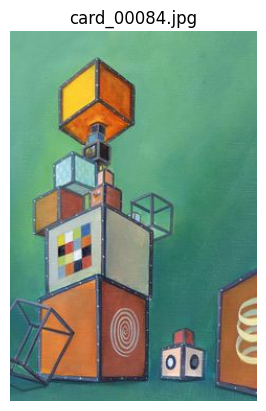


Top 10 retrieved keywords:
CPU times: user 1min 47s, sys: 25.1 s, total: 2min 12s
Wall time: 2min 17s


[(tensor(0.0058), 'art'),
 (tensor(0.0031), 'stack'),
 (tensor(0.0027), 'tower'),
 (tensor(0.0026), 'canvas'),
 (tensor(0.0026), 'invention'),
 (tensor(0.0016), 'complex'),
 (tensor(0.0013), 'paint'),
 (tensor(0.0012), 'drawing'),
 (tensor(0.0009), 'drawn'),
 (tensor(0.0009), 'sculpture')]

In [ ]:
%%time
random.seed(42)
test_img = random.choice(cards_folder)
print("Testing with image:\n")
show_card(test_img)
results = siglip_inference_image_to_text(siglip_model, siglip_processor,
                                         Image.open(test_img), vocabulary_unified)
print("\nTop 10 retrieved keywords:")
results[:10]

Testing with image:



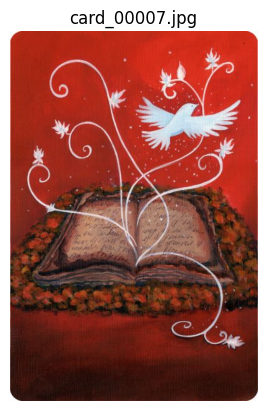


Top 10 retrieved keywords:
CPU times: user 1min 46s, sys: 25 s, total: 2min 11s
Wall time: 2min 12s


[(tensor(0.0163), 'poetry'),
 (tensor(0.0116), 'book'),
 (tensor(0.0031), 'verse'),
 (tensor(0.0028), 'peace'),
 (tensor(0.0027), 'magic'),
 (tensor(0.0020), 'existence'),
 (tensor(0.0017), 'reading'),
 (tensor(0.0013), 'outstretched'),
 (tensor(0.0011), 'surrounded'),
 (tensor(0.0011), 'love')]

In [ ]:
%%time
random.seed(123)
test_img = random.choice(cards_folder)
print("Testing with image:\n")
show_card(test_img)
results = siglip_inference_image_to_text(siglip_model, siglip_processor,
                                         Image.open(test_img), vocabulary_unified)
print("\nTop 10 retrieved keywords:")
results[:10]

## 4) LLM: Meta's Llama 3.2

In the beginning, I was planning to try out OpenAI's GPT APIs with whathever model would be free to use. Unfortunately, it seems that since a few months OpenAI withdrew the free temporary access to all GPT models to users that didn't subscribe to any billing plan. Therefore, the idea of using GPT decayed and I looked for alternatives in the LLM ecosystem.

After some search, a promising middle ground in terms of the performance/computational costs ratio was provided by **Meta's LLama 3.2 with 3B paramters**, a text-only Large Language Model freely available on HuffingFace made even faster and lightweight to use with [Unsloth](https://huggingface.co/unsloth). This model fits well on-device and has proved to have great generation capabilities for the necessities of this project.

Here I proceed to load it and set it up before involving it directly in the agent's code:

In [ ]:
%%capture
!pip install unsloth
!pip install -U bitsandbytes
!pip install --force-reinstall --no-cache-dir --no-deps git+https://github.com/unslothai/unsloth.git

In [ ]:
# In case unsloth gives error about pitsandbytes package, decomment and run
#!pip uninstall bitsandbytes
#!pip install bitsandbytes

# In case there are issues with packages versions, either downgrade numpy or upgrade transformers
#!pip install "numpy<2"
#!pip install --upgrade transformers unsloth

In [ ]:
import unsloth
from unsloth import FastLanguageModel

max_seq_length = 2048 # Choose any! We auto support RoPE Scaling internally!
dtype = None # None for auto detection. Float16 for Tesla T4, V100, Bfloat16 for Ampere+
load_in_4bit = True # Use 4bit quantization to reduce memory usage. Can be False.

# 4bit pre quantized models we support for 4x faster downloading + no OOMs.
fourbit_models = [
    "unsloth/Meta-Llama-3.1-8B-bnb-4bit",      # Llama-3.1 2x faster
    "unsloth/Meta-Llama-3.1-8B-Instruct-bnb-4bit",
    "unsloth/Meta-Llama-3.1-70B-bnb-4bit",
    "unsloth/Meta-Llama-3.1-405B-bnb-4bit",    # 4bit for 405b!
    "unsloth/Mistral-Small-Instruct-2409",     # Mistral 22b 2x faster!
    "unsloth/mistral-7b-instruct-v0.3-bnb-4bit",
    "unsloth/Phi-3.5-mini-instruct",           # Phi-3.5 2x faster!
    "unsloth/Phi-3-medium-4k-instruct",
    "unsloth/gemma-2-9b-bnb-4bit",
    "unsloth/gemma-2-27b-bnb-4bit",            # Gemma 2x faster!

    "unsloth/Llama-3.2-1B-bnb-4bit",           # NEW! Llama 3.2 models
    "unsloth/Llama-3.2-1B-Instruct-bnb-4bit",
    "unsloth/Llama-3.2-3B-bnb-4bit",
    "unsloth/Llama-3.2-3B-Instruct-bnb-4bit",

    "unsloth/Llama-3.3-70B-Instruct-bnb-4bit" # NEW! Llama 3.3 70B!
] # More models at https://huggingface.co/unsloth

llama_model, llama_tokenizer = FastLanguageModel.from_pretrained(
    model_name = "unsloth/Llama-3.2-3B-Instruct", # or choose "unsloth/Llama-3.2-1B-Instruct"
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
    # token = "hf_...", # use one if using gated models like meta-llama/Llama-2-7b-hf
)

🦥 Unsloth: Will patch your computer to enable 2x faster free finetuning.
🦥 Unsloth Zoo will now patch everything to make training faster!
==((====))==  Unsloth 2025.1.5: Fast Llama patching. Transformers: 4.47.1.
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform: Linux.
O^O/ \_/ \    Torch: 2.5.1+cu121. CUDA: 7.5. CUDA Toolkit: 12.1. Triton: 3.1.0
\        /    Bfloat16 = FALSE. FA [Xformers = 0.0.29.post1. FA2 = False]
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth
Unsloth: Fast downloading is enabled - ignore downloading bars which are red colored!


model.safetensors:   0%|          | 0.00/2.24G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/234 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/54.6k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/17.2M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/454 [00:00<?, ?B/s]

In [ ]:
# Thanks to LoRA adapters, we only need to update 1 to 10% of all parameters!
llama_model = FastLanguageModel.get_peft_model(
    llama_model,
    r = 16, # Choose any number > 0 ! Suggested 8, 16, 32, 64, 128
    target_modules = ["q_proj", "k_proj", "v_proj", "o_proj",
                      "gate_proj", "up_proj", "down_proj",],
    lora_alpha = 16,
    lora_dropout = 0, # Supports any, but = 0 is optimized
    bias = "none",    # Supports any, but = "none" is optimized
    # [NEW] "unsloth" uses 30% less VRAM, fits 2x larger batch sizes!
    use_gradient_checkpointing = "unsloth", # True or "unsloth" for very long context
    random_state = 3407,
    use_rslora = False,  # We support rank stabilized LoRA
    loftq_config = None, # And LoftQ
)

Unsloth 2025.1.5 patched 28 layers with 28 QKV layers, 28 O layers and 28 MLP layers.


In [ ]:
%%capture
from unsloth.chat_templates import get_chat_template

llama_tokenizer = get_chat_template(
    llama_tokenizer,
    chat_template = "llama-3.1", # use the template of llama 3.2
)
FastLanguageModel.for_inference(llama_model) # Enable native 2x faster inference

## 5) Agent implementation

In order to implement our bot, the two roles of the storyteller and the guesser were developed separately.

- **Storyteller**: the goal of the storyteller is, given an image, to output a clue.<br>
We are following the direction of Image-to-Text. The first step we need to take is image understanding: to let the agent have an idea of what's contained in the image, we will employ SigLIP and the text corpus we crafted to retrieve a number of keywords that are associated to the image. These keywords will likely refer to objects, or actions, or concepts that SigLIP recognizes in the image. <br>
Now, if we just put keywords in a sentence, the clue will always be very obvious. The essence of Dixit as a game relies precisely in the ambiguity of the clue, so we cannot be satisfied yet. To add the abstraction ingredient, we prompt the LLM to produce three candidate clues explicitly specifying that they should be "creative, ambiguous, Dixit-style and in a maximum of 10 words each". In addition, we require that the top keyword doesn't appear in any clue because it might refer to a subject too clear to recognize in a card. <br>
Finally, to select the best clue we simply pass them to SigLIP again and have it output the one that has the best matching probability with the input image. The best clue will be the clue that the storyteller gives to the other players. <br>
Summary of the implementation steps:
  1. Keywords retrieval with SigLIP;
  2. Preparation of candidate clues with Llama, based on the keywords;
  3. Selection of the best clue using SigLIP.

- **Guesser**: the goal of the guesser is, given a textual clue, find the image that best matches it from a pool.<br>
We are following the direction of Text-to-Image. This task is somewhat easier than the storyteller's, because it doesn't need to find compatible text to the images from scratch. Now we have a clue. However, to apply SigLIP directly would be a poor strategy, as we wouldn't be taking into account the ingredient that we struggled so much to add in the storyteller: abstraction. Therefore, we employ the LLM again to help us "decoding" the clue: we prompt it to think of possible scenarios describes in an image associated to the input clue and output a set of keywords possibly associated to those scenarios. The keywords are then combined in a single string that is passed to SigLIP, hoping it works kind of like a conjunctive query, which then sorts the pool of images according to the matching probability to the string. The best matching image will be returned as the final guess. <br>
Summary of the implementation steps:
  1. Keywords extraction with Llama;
  2. Preparation of a query based on keywords;
  3. Selection of the best matching image using SigLIP.


### 5.1) The Storyteller Role

In this section I implement the Storyteller's role and run some simple example to test that everything's working:

In [ ]:
### STORYTELLER'S FUNCTIONS ###

def retrieve_topk_words(input_image, input_vocabulary = vocabulary_unified, k = 10):
    '''
    Function to compute the keywords associated to an image
    from a given vocabulary. The top k are returned.
    '''
    # Rank words in vocabulary by similarity with input image
    ranked_vocabulary = siglip_inference_image_to_text(siglip_model,
                                                     siglip_processor,
                                                     Image.open(input_image),
                                                     input_vocabulary)
    # Extract top k keywords
    topk_keywords = [word for prob, word in ranked_vocabulary[:k]]
    return topk_keywords


def unpack_storyteller_output(text):
    '''
    Function to process the LLM output and extract the clues.
    '''

    # Define a regex to extract descriptions from LLM output
    pattern = r'\d+\)?[:\.\s]*["\']?[a-zA-Z\s\']*["\']?'
    # - \d+ matches one or more digits like 1, 2, 3, etc.
    # - \)? matches optional parenthesis in the case of 1), 2), 3)
    # - [:\.\s]* matches any combination of :, ., or spaces that may follow
    # - ?:"([^"]+)" catches anything inside "" quotes
    # - | means or
    # - (.+) catches any text without "" quotes

    # Return list of strings matching the regex
    clues = re.findall(pattern, text)
    clues = [c.strip('\n 12345)."\'') for c in clues]
    return clues


def prompt_llama_storyteller(model, tokenizer, keywords):
    '''
    Function to pass a prompt to Llama 3.2 and return its answer as a string.

    Storyteller's prompt:
    "We are playing the Dixit board game.
    You are the storyteller for this turn. The card you choose to play
    is associated to the keywords: {keywords} in decreasing order of
    matching probability. Give three different creative, ambiguous,
    Dixit-style descriptions for your image, in maximum 10 words each.
    No description can contain the first keyword."

    The keywords are passed as a parameter.
    '''

    # Define input message
    message = [
        {"role": "user",
        "content": f"We are playing the Dixit board game. You are the storyteller for this turn. The card you choose to play is associated to the keywords: {keywords} in decreasing order of matching probability. Give three different creative, ambiguous, Dixit-style descriptions for your image, in maximum 10 words each. No description can contain the first keyword."}
    ]

    inputs = tokenizer.apply_chat_template(
        message,
        tokenize = True,
        add_generation_prompt = True, # Must add for generation
        return_tensors = "pt",
    ).to(device)

    # Get output generated by the model
    outputs = model.generate(input_ids = inputs, max_new_tokens = 128, use_cache = True, temperature = 1.5, min_p = 0.1)
    tokenized_output = tokenizer.batch_decode(outputs)
    #print(tokenized_output)

    tokenized_output = tokenized_output[0].split('assistant')[1]

    # Extract clues from model's response
    unpacked_output = unpack_storyteller_output(tokenized_output)

    return unpacked_output


def get_top_clue(image, clues_list, Ipa = False):
    '''
    Function to retrieve the clue that best matches the original image.
    - image is a string path to image
    - clues is a list of strings containing candidate clues
    '''
    #print(clues_list)
    if Ipa:
        ranked_clues = siglip_inference_image_to_text(siglip_model,
                                                      siglip_processor,
                                                      Ipa_image,
                                                      clues_list)
    else:
        ranked_clues = siglip_inference_image_to_text(siglip_model,
                                                      siglip_processor,
                                                      Image.open(image),
                                                      clues_list)
    # Return best matching clue
    top_desc = ranked_clues[0][1]
    return top_desc


def storyteller_routine(chosen_image, vocabulary = vocabulary_unified, Ipa = False):
    '''
    Function that activates when it's the storyteller's turn.
    It takes as input the the image for the other players to guess
    and it outputs a lexical clue.
    '''
    # 1. Retrieve the top k words matching the image
    k = 10
    topk_words_from_vocabulary = retrieve_topk_words(chosen_image, vocabulary, k)

    # 2. Feed the keywords to the LLM and get 3 candidate clues
    llama_candidate_clues = prompt_llama_storyteller(llama_model,
                                                     llama_tokenizer,
                                                     topk_words_from_vocabulary)

    # 3. Extract the clue that best matches the image
    if Ipa:
        top_clue = get_top_clue(chosen_image, llama_candidate_clues, Ipa)
    else:
        top_clue = get_top_clue(chosen_image, llama_candidate_clues)

    # 4. Return clue
    return top_clue

Testing:

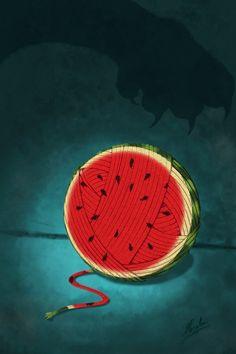

In [ ]:
test_img = "/content/cards/card_00013.jpg"
Image.open(test_img)

In [ ]:
retrieve_topk_words(test_img, vocabulary_unified)

['watermelon',
 'thread',
 'fruit',
 'worm',
 'bitter',
 'whip',
 'bite',
 'broken',
 'seed',
 'ball']

In [ ]:
keywords = ['red', 'watermelon', 'knife']
llama_response = prompt_llama_storyteller(llama_model, llama_tokenizer, keywords)
llama_response

The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


['Red watermelon slicing ninja silently sneaks up.',
 'Fiery red ninja stealthily slices juicy red watermelon.',
 'Red-helmeted ninja wields knife, eyes on crimson watermelon.']

In [ ]:
get_top_clue(test_img, llama_response)

'Fiery red ninja stealthily slices juicy red watermelon.'

#### Tests

Testing with image:



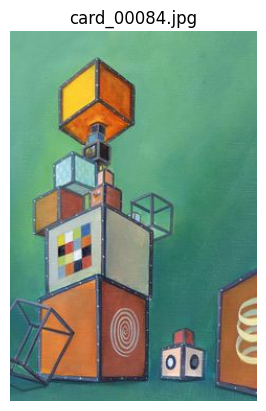

The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.




Storyteller's clue: Whimsical tower of wonder


CPU times: user 1min 56s, sys: 27.8 s, total: 2min 24s
Wall time: 2min 56s


In [ ]:
%%time
random.seed(42)
test_img = random.choice(cards_folder)
print("Testing with image:\n")
show_card(test_img)

clue = storyteller_routine(test_img)
print("\n" + "=" * 100 + "\n")
print("Storyteller's clue:", clue)
print("\n" + "=" * 100 + "\n")

Testing with image:



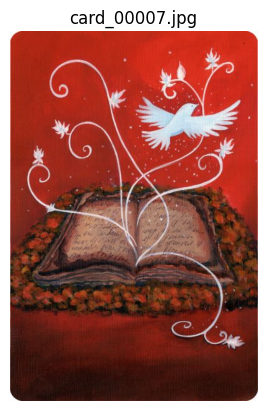



Storyteller's clue: Moss and feathers entwine in quiet reverence


CPU times: user 1min 51s, sys: 25.9 s, total: 2min 17s
Wall time: 2min 21s


In [ ]:
%%time
random.seed(123)
test_img = random.choice(cards_folder)
print("Testing with image:\n")
show_card(test_img)

clue = storyteller_routine(test_img)
print("\n" + "=" * 100 + "\n")
print("Storyteller's clue:", clue)
print("\n" + "=" * 100 + "\n")

Testing with image:



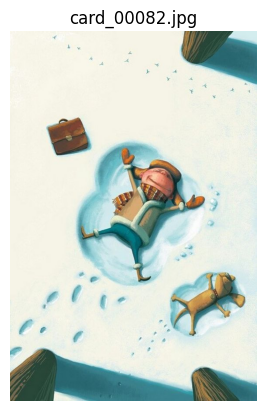



Storyteller's clue: Father leaps high with outstretched arms


CPU times: user 1min 50s, sys: 25.7 s, total: 2min 15s
Wall time: 2min 18s


In [ ]:
%%time
random.seed(5)
test_img = random.choice(cards_folder)
print("Testing with image:\n")
show_card(test_img)

clue = storyteller_routine(test_img)
print("\n" + "=" * 100 + "\n")
print("Storyteller's clue:", clue)
print("\n" + "=" * 100 + "\n")

---

### 5.2) The Guesser Role

In this section I implement the Guesser's role and run some simple example to test that everything's working:

In [ ]:
### GUESSER'S FUNCTIONS ###


def unpack_guesser_output(text):
    '''
    Function to process the LLM output and extract the keywords.
    '''
    # Define a regex to extract descriptions from LLM output
    #pattern = r'\d+\)?[:\.\s]*["\']?[a-zA-Z\s]*["\']?'
    pattern = r'\n\d+\)?[:\.\s]*["\']?([A-Za-z]+)["\']?'
    # - \d+ matches one or more digits like 1, 2, 3, etc.
    # - \)? matches optional parenthesis in the case of 1), 2), 3)
    # - [:\.\s]* matches any combination of :, ., or spaces that may follow
    # - ([A-Za-z]+) catches a character sequence of at least 1 letter

    # Return list of strings matching the regex
    keywords = re.findall(pattern, text)
    keywords = [k.strip('\n 1234567890)."\'') for k in keywords]

    return keywords


def prompt_llama_guesser(model, tokenizer, clue):
    '''
    Function to pass a prompt to Llama 3.2 and return its answer as a string.

    Guesser's prompt:
    "We are playing the Dixit board game. The storyteller just gave you
    this clue: {clue}. We need to guess his card. Based on the clue,
    come up with the most important 5 keywords that might be associated
    with the image the clue could refer to."

    The clue is passed as a parameter.
    '''

    # Define input message
    message = [
        {"role": "user",
        "content": f"We are playing the Dixit board game. The storyteller just gave you this clue: {clue}. We need to guess his card. Based on the clue, come up with the most important 10 keywords that might be associated with the image the clue refers to."}
    ]

    inputs = tokenizer.apply_chat_template(
        message,
        tokenize = True,
        add_generation_prompt = True, # Must add for generation
        return_tensors = "pt",
    ).to(device)


    outputs = model.generate(input_ids = inputs, max_new_tokens = 128, use_cache = True,
                            temperature = 1.5, min_p = 0.1)
    tokenized_output = tokenizer.batch_decode(outputs)

    tokenized_output = tokenized_output[0].split('assistant')[1]
    unpacked_output = unpack_guesser_output(tokenized_output)

    return unpacked_output


def get_top_image(keywords, image_list, Ipa = False):

    # Combine all keywords in a single string
    # (pass it to CLIP kinda like a conjunctive query)
    keywords_string = " ".join(keywords)

    ranked_images = siglip_inference_text_to_image(siglip_model,
                                                   siglip_processor,
                                                   image_list,
                                                   keywords_string)
    # Extract best matching image
    top_image = ranked_images[0][1]
    return top_image


def show_card(image_path):
    fig = plt.figure()
    img = imread(image_path)
    plt.axis('off')
    plt.imshow(img)
    plt.title(image_path.split('/')[-1])
    plt.show()
    plt.close(fig)
    return


def plot_hand_of_cards(image_path_list, n = 5):
    '''
    Function that displays a hand of 5 images, including the
    one to guess, to the players.
    '''

    fig, axes = plt.subplots(1, 5, figsize = (15, 5))
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        img = imread(image_path_list[i])
        ax.imshow(img)
        ax.set_title(f"Card {i+1}:\n{image_path_list[i].split('/')[-1]}")
        ax.axis('off')

    #fig.suptitle('Guess the card!\n', fontsize = 20)
    plt.tight_layout()
    plt.show()

    return


def guesser_routine(given_clue, cards_hand, Ipa = False):
  '''
  Function that activates when it's the guesser's turn.
  It takes as input the the given clue from the storyteller and a
  hand of cards for the current turn, and it outputs its best guess.
  '''
  # 1. Process the clue and extract keywords
  llama_keywords_from_clue = prompt_llama_guesser(llama_model,
                                                  llama_tokenizer,
                                                  given_clue)

  # 2. Extract the image that best matches the set of keywords
  top_image = get_top_image(llama_keywords_from_clue, cards_hand, Ipa)

  # 4. Return image guess
  return top_image

Testing:

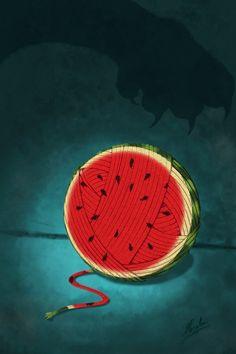

In [ ]:
test_img = "/content/cards/card_00013.jpg"
Image.open(test_img)

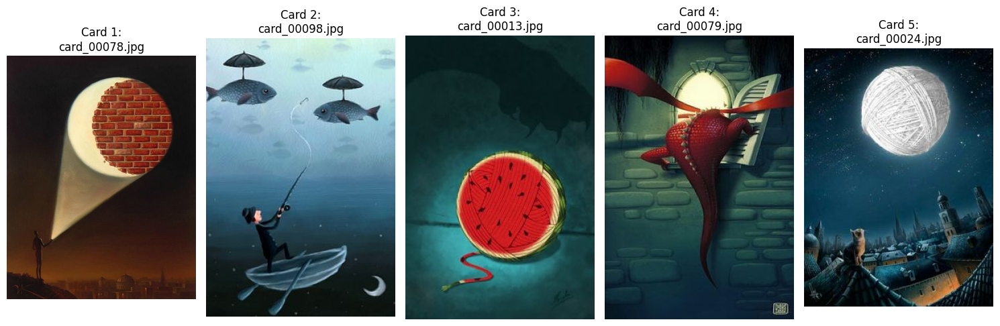

In [ ]:
image_pool = random.sample(cards_folder, 4) + [test_img]
random.shuffle(image_pool)

plot_hand_of_cards(image_pool)

In [ ]:
llama_guesser_response = prompt_llama_guesser(llama_model, llama_tokenizer, clue)
llama_guesser_response

['Seed',
 'Break',
 'Fragile',
 'Thread',
 'Ripe',
 'Bitter',
 'Fate',
 'Garden',
 'Plant',
 'Injury']

In [ ]:
top_image = get_top_image(llama_guesser_response, image_pool)
top_image

'/content/cards/card_00013.jpg'

I choose card_00013.jpg. This is my guess!



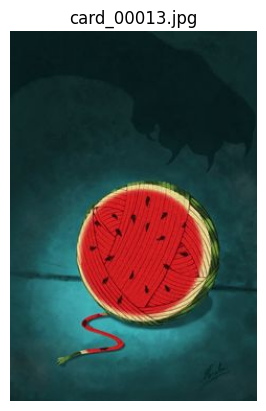

In [ ]:
print(f"I choose {top_image.split('/')[-1]}. This is my guess!\n")
show_card(top_image)

#### Tests


Testing with clue: "Whimsical tower of wonder"

Guessing among the images:



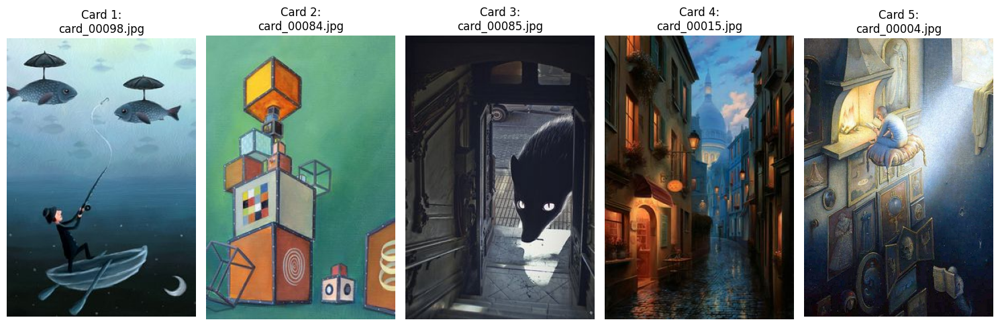



My guess is: /content/cards/card_00004.jpg
The right card was: /content/cards/card_00084.jpg


CPU times: user 9.35 s, sys: 81.7 ms, total: 9.43 s
Wall time: 11.8 s


In [ ]:
%%time
random.seed(42)

clue = "Whimsical tower of wonder"
print(f'\nTesting with clue: "{clue}"')

test_img = "/content/cards/card_00084.jpg"
image_pool = random.sample([c for c in cards_folder if c != test_img], 4) + [test_img]
random.shuffle(image_pool)
print("\nGuessing among the images:\n")
plot_hand_of_cards(image_pool)

guess = guesser_routine(clue, image_pool)
print("\n" + "=" * 100 + "\n")
print("My guess is:", guess)
print("The right card was:", test_img)
print("\n" + "=" * 100 + "\n")


Testing with clue: "Moss and feathers entwine in quiet reverence"

Guessing among the images:



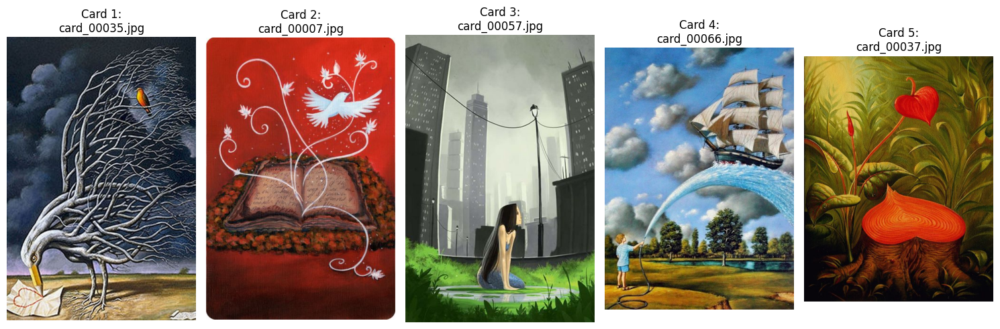



My guess is: /content/cards/card_00035.jpg
The right card was: /content/cards/card_00007.jpg


CPU times: user 11.4 s, sys: 102 ms, total: 11.5 s
Wall time: 14.4 s


In [ ]:
%%time
random.seed(45)

clue = "Moss and feathers entwine in quiet reverence"
print(f'\nTesting with clue: "{clue}"')

test_img = "/content/cards/card_00007.jpg"
image_pool = random.sample([c for c in cards_folder if c != test_img], 4) + [test_img]
random.shuffle(image_pool)
print("\nGuessing among the images:\n")
plot_hand_of_cards(image_pool)

guess = guesser_routine(clue, image_pool)
print("\n" + "=" * 100 + "\n")
print("My guess is:", guess)
print("The right card was:", test_img)
print("\n" + "=" * 100 + "\n")


Testing with clue: "Father leaps high with outstretched arms"

Guessing among the images:



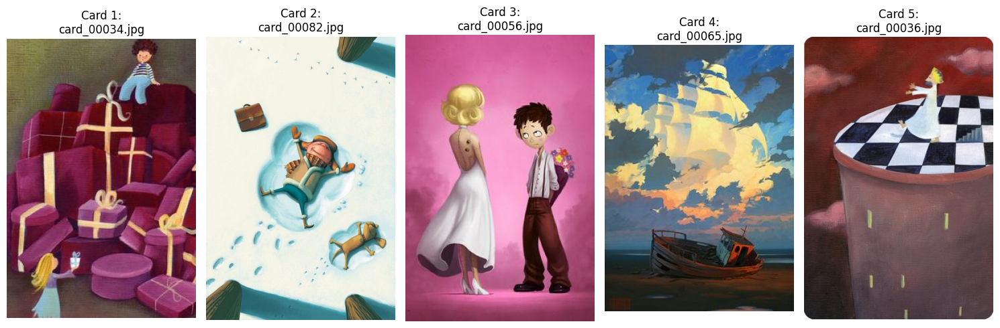



My guess is: /content/cards/card_00082.jpg
The right card was: /content/cards/card_00082.jpg


CPU times: user 11.8 s, sys: 118 ms, total: 12 s
Wall time: 14.4 s


In [ ]:
%%time
random.seed(45)

clue = "Father leaps high with outstretched arms"
print(f'\nTesting with clue: "{clue}"')

test_img = "/content/cards/card_00082.jpg"
image_pool = random.sample([c for c in cards_folder if c != test_img], 4) + [test_img]
random.shuffle(image_pool)
print("\nGuessing among the images:\n")
plot_hand_of_cards(image_pool)

guess = guesser_routine(clue, image_pool)
print("\n" + "=" * 100 + "\n")
print("My guess is:", guess)
print("The right card was:", test_img)
print("\n" + "=" * 100 + "\n")

## 6) Storyteller tests

In this section, I collect all the experiments run to evaluate my Storyteller against human and bot players. <br>

**Tldr;** most clues are obvious, but look at Round 5, 6, 9, 13 for slightly better results.

In [ ]:
cards_played = []

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Invisible strings tie fate to a mystical bridge". This are the cards you can choose from:



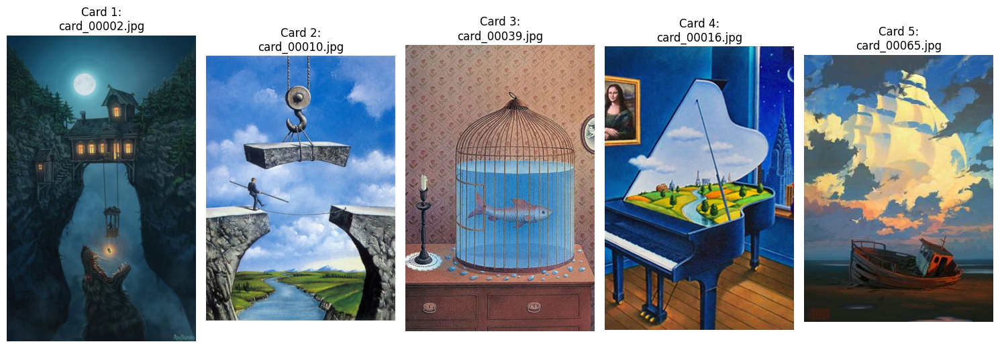

In [ ]:
# Round 1
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample(cards_played, 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?2
CONGRATS! You are right!!! That's a +1 for you.


GPT4-o says image: 2

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Winter spirit jumps into the arms of a loving parent". This are the cards you can choose from:



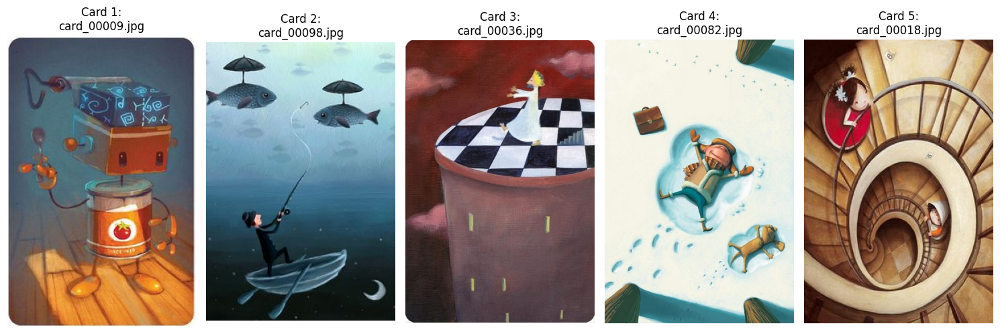

In [ ]:
# Round 2
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?4
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 4

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Dreams are built in cozy realms". This are the cards you can choose from:



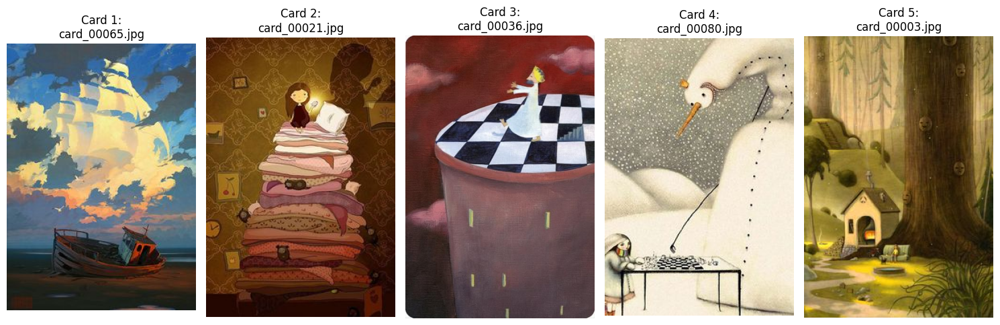

In [ ]:
# Round 3
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?2
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 2

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Mysterious box that holds the secret to eternal art". This are the cards you can choose from:



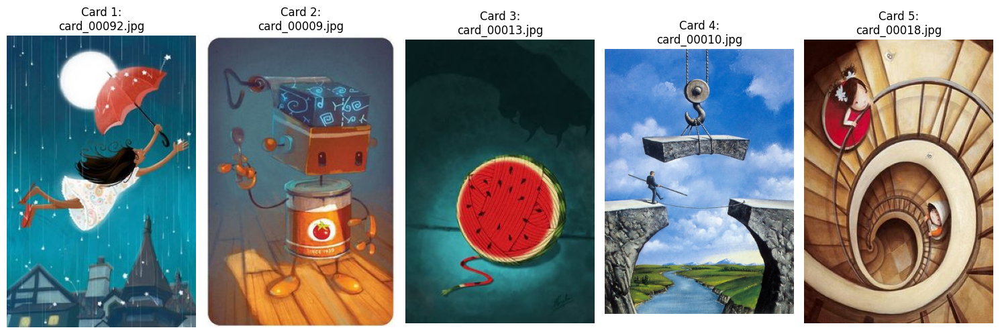

In [ ]:
# Round 4
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?2
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 2

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "The last knight of the kingdom dies of old age". This are the cards you can choose from:



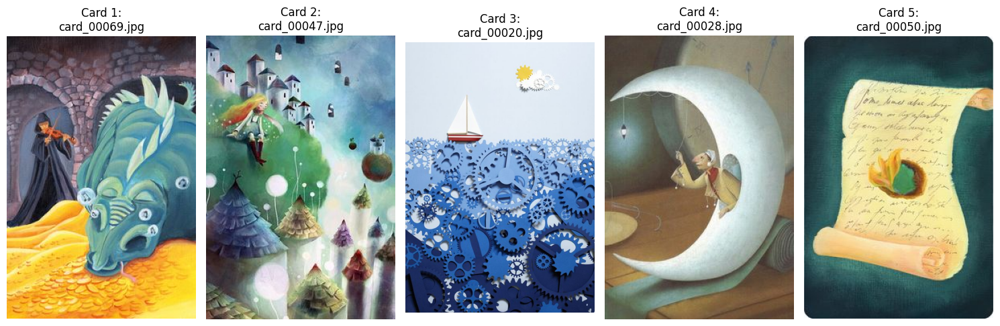

In [ ]:
# Round 5
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

Can you guess what image (1-5) it refers to?2
Oh, nooo. Better luck next time. My card was:


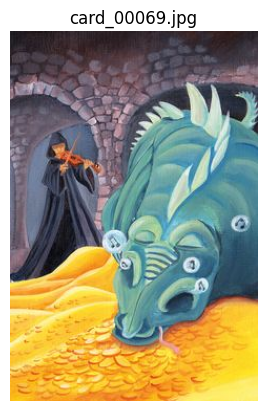

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

GPT-4o says image: 1

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Soft glow within a moonlit". This are the cards you can choose from:



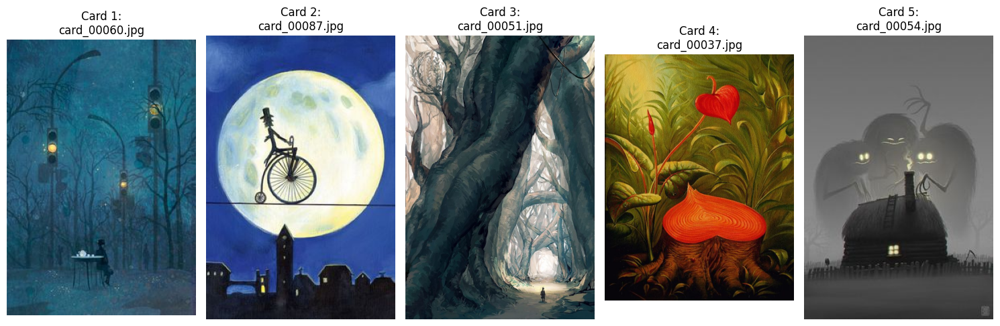

In [ ]:
# Round 6
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

Can you guess what image (1-5) it refers to?2
Oh, nooo. Better luck next time. My card was:


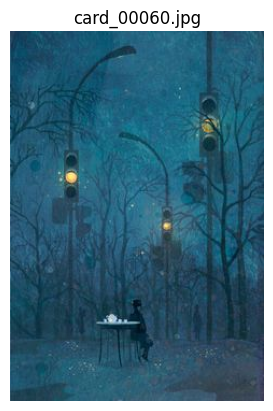

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

GPT-4o says image: 1

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Golden hues seep into the heart of a hollow cave". This are the cards you can choose from:



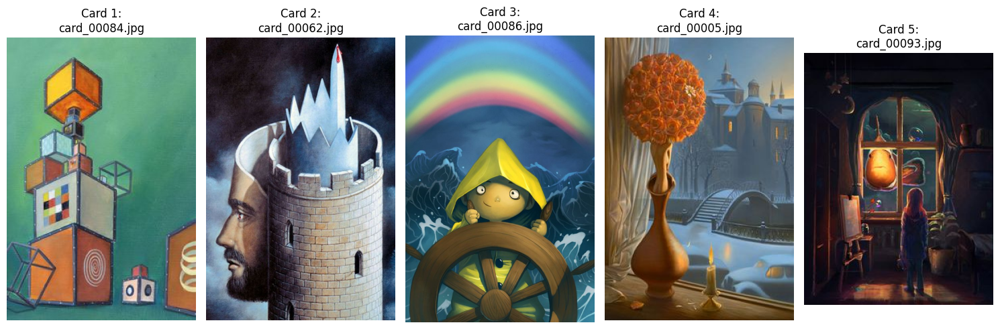

In [ ]:
# Round 7
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?5
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 5

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "A glowing moonbeam catches a cat in a rocket ball". This are the cards you can choose from:



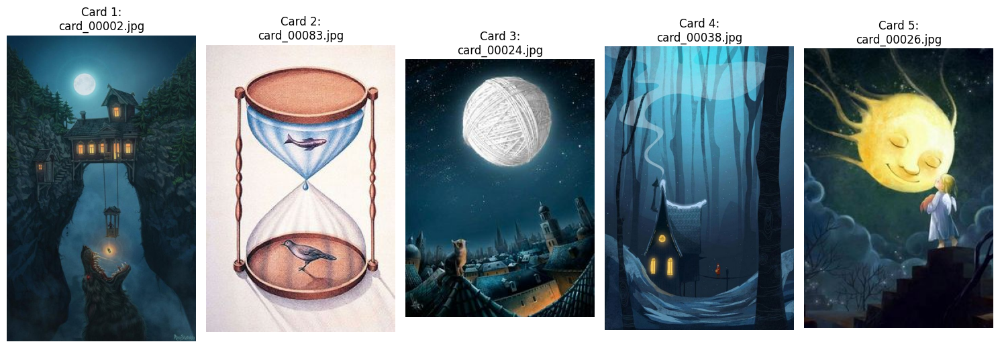

In [ ]:
# Round 8
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?3
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 3

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "A lone traveler awakens in a woodland village nest". This are the cards you can choose from:



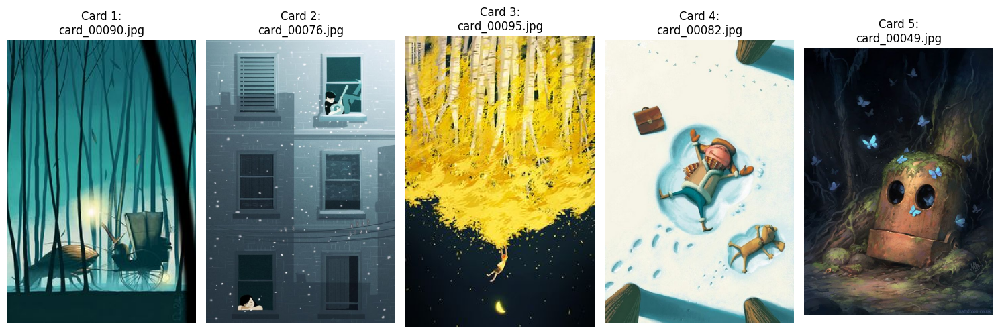

In [ ]:
# Round 9
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

Can you guess what image (1-5) it refers to?5
Oh, nooo. Better luck next time. My card was:


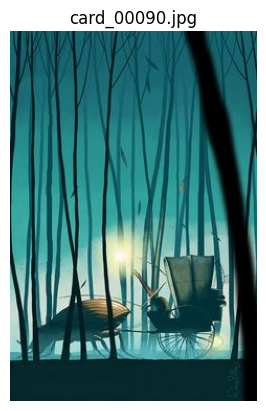

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

GPT-4o says image: 1

---


I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "A delicate leaf unfurls". This are the cards you can choose from:



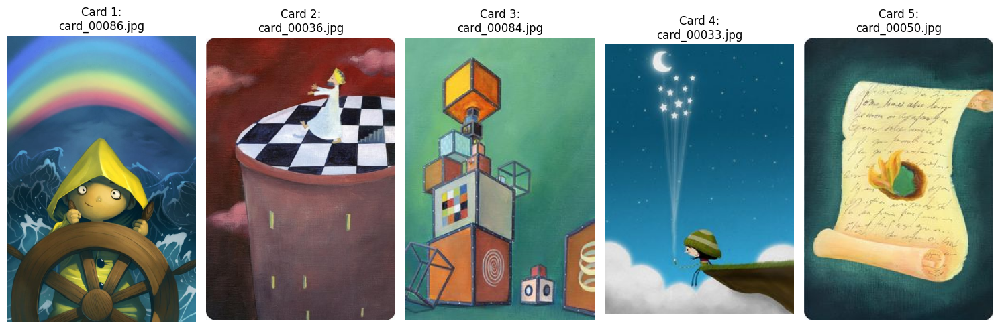

In [ ]:
# Round 10
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?5
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 5

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Flora's poignant melody entices the forest's most devoted admirer". This are the cards you can choose from:



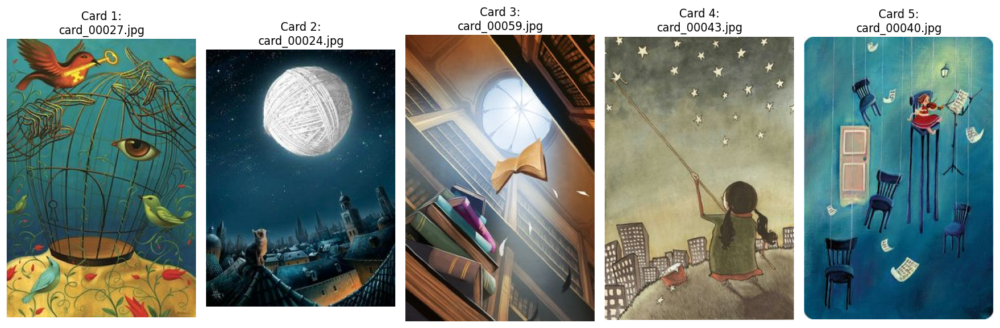

In [ ]:
# Round 11
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?1
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 1

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Moonlit magic flows from an enchanted instrument's curves nightly". This are the cards you can choose from:



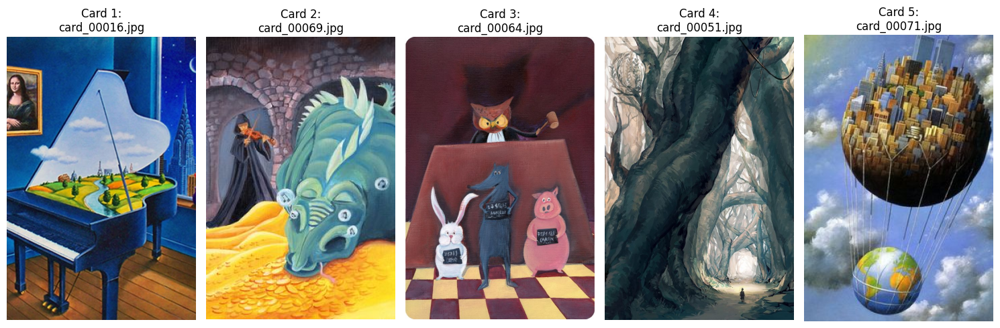

In [ ]:
# Round 12
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?1
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 1


---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Garden of bitter temptation with a stringy heart". This are the cards you can choose from:



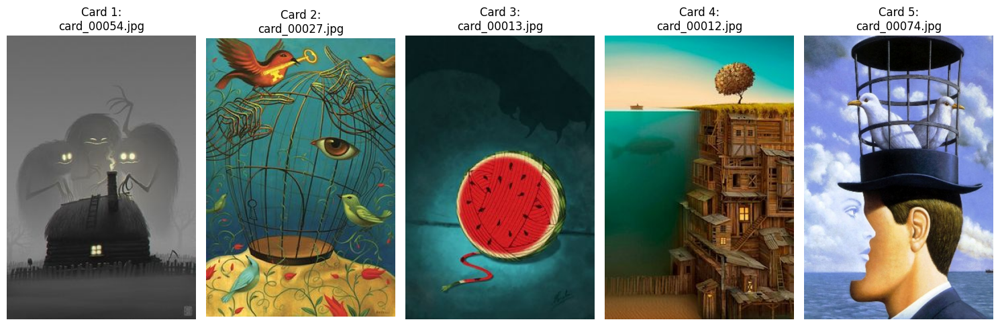

In [ ]:
# Round 13
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

Can you guess what image (1-5) it refers to?2
Oh, nooo. Better luck next time. My card was:


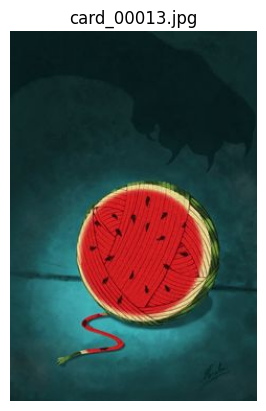

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

GPT-4o says image: 2

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "Ghostly figures dance in misty morning". This are the cards you can choose from:



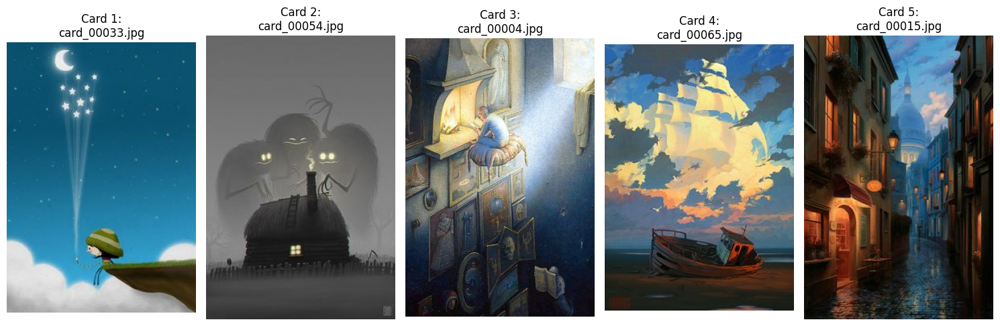

In [ ]:
# Round 14
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?2
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 1
2

---

I'll be the Storyteller for this round!

Mmmh... let me think...

Got it! My clue is: "In the heart of the forest". This are the cards you can choose from:



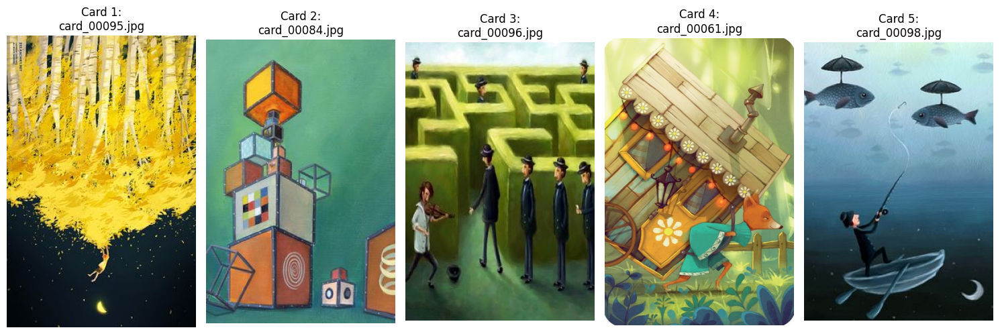

In [ ]:
# Round 15
print("I'll be the Storyteller for this round!\n")

chosen_image = random.choice([c for c in cards_folder if c not in cards_played])
cards_played.append(chosen_image)

print("Mmmh... let me think...\n")
clue = storyteller_routine(chosen_image)
print(f'Got it! My clue is: "{clue}". This are the cards you can choose from:\n')

cards_hand = random.sample([img for img in cards_folder if img != chosen_image], 4) + [chosen_image]
random.shuffle(cards_hand)

plot_hand_of_cards(cards_hand)

In [ ]:
user_input = int(input("Can you guess what image (1-5) it refers to?"))

if cards_hand[user_input - 1] == chosen_image:
    print("CONGRATS! You are right!!! That's a +1 for you.")
else:
    print("Oh, nooo. Better luck next time. My card was:")
    show_card(chosen_image)

Can you guess what image (1-5) it refers to?1
CONGRATS! You are right!!! That's a +1 for you.


GPT-4o says image: 1

## 7) Guesser tests

In this section, I collect all the experiments run to evaluate my Guesser against human and bot players. <br>

**Tldr;** the agent almost never guesses right, except for Round 1, 2, 8.

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



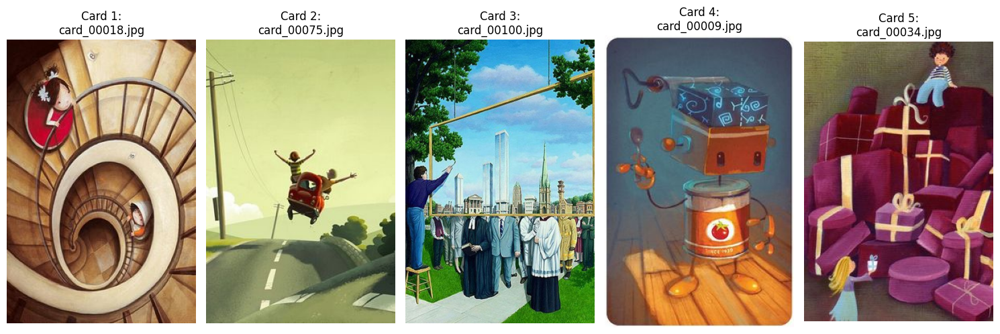

In [ ]:
# Round 1
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(1)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 75)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:towards the horizon and beyond
Mmmh... let me see...
My guess is: /content/cards/card_00075.jpg.
Am I correct (y/n)?y
YU-HUUUU! This is one point for me!


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



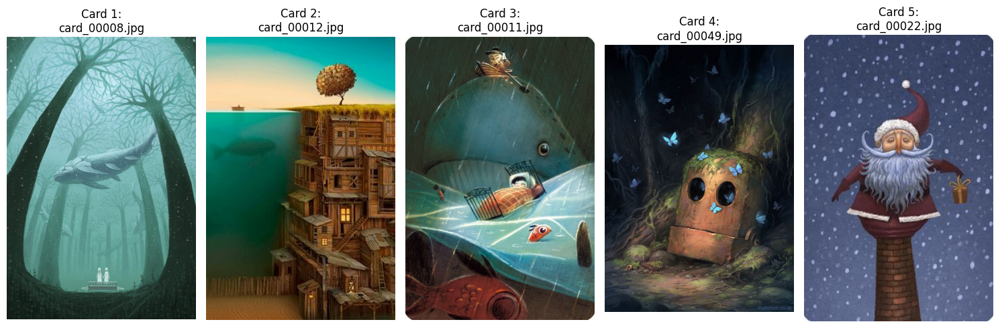

In [ ]:
# Round 2
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(2)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 49)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:ash to ash, dust to dust
Mmmh... let me see...
My guess is: /content/cards/card_00049.jpg.
Am I correct (y/n)?y
YU-HUUUU! This is one point for me!


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



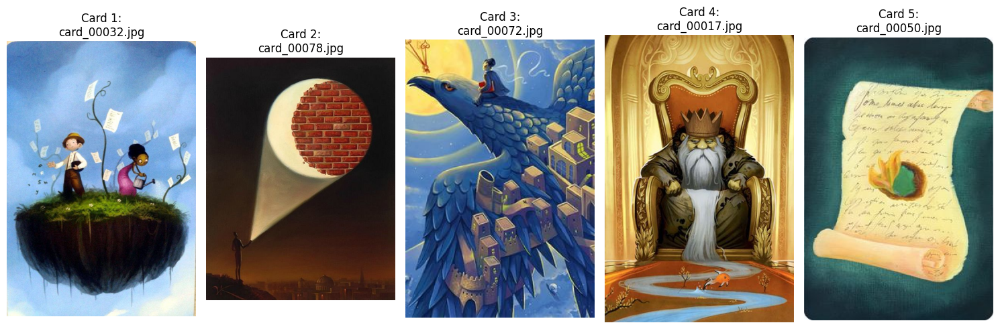

In [ ]:
# Round 3
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(3)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 32)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:valuable papers


The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


Mmmh... let me see...
My guess is: /content/cards/card_00050.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



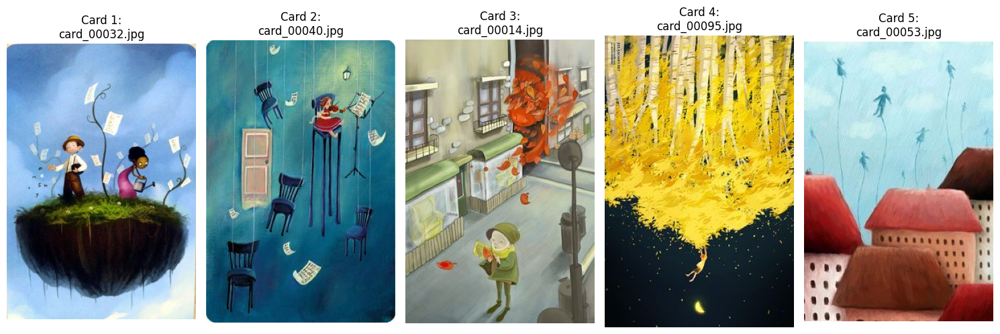

In [ ]:
# Round 4
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(4)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 40)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:memories floating away
Mmmh... let me see...
My guess is: /content/cards/card_00032.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



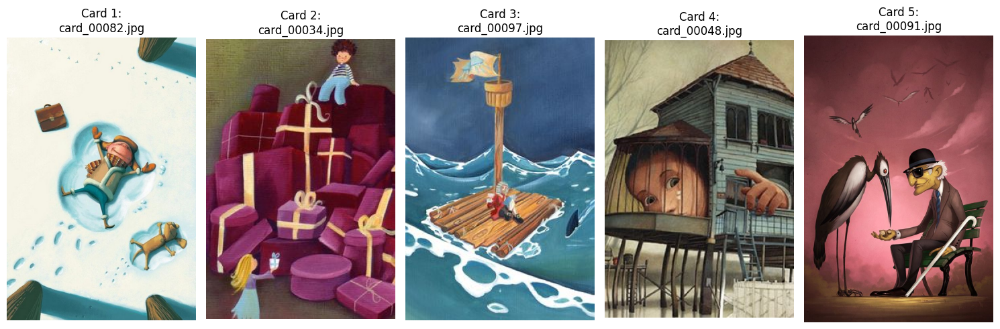

In [ ]:
# Round 5
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(5)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 97)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:a prison of loneliness
Mmmh... let me see...
My guess is: /content/cards/card_00048.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



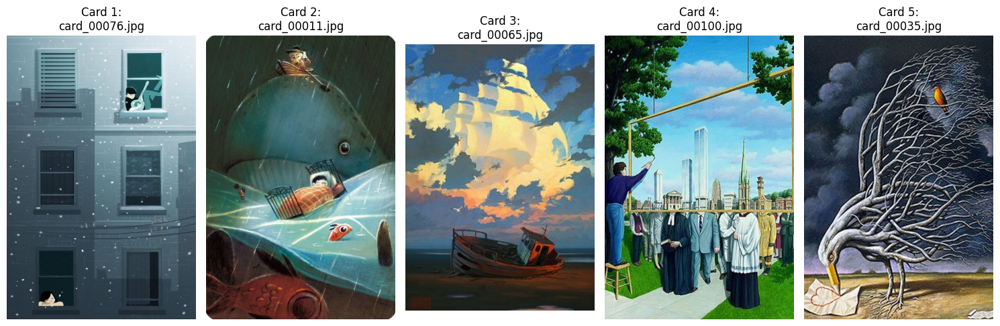

In [ ]:
# Round 6
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(6)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 65)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:unrealistic aspirations
Mmmh... let me see...
My guess is: /content/cards/card_00050.jpg.
Am I correct (y/n)?
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



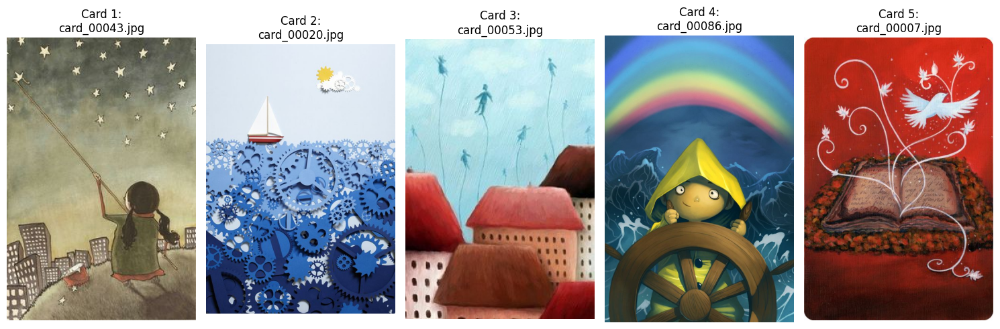

In [ ]:
# Round 7
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(7)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 86)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:don't stop believing
Mmmh... let me see...
My guess is: /content/cards/card_00020.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



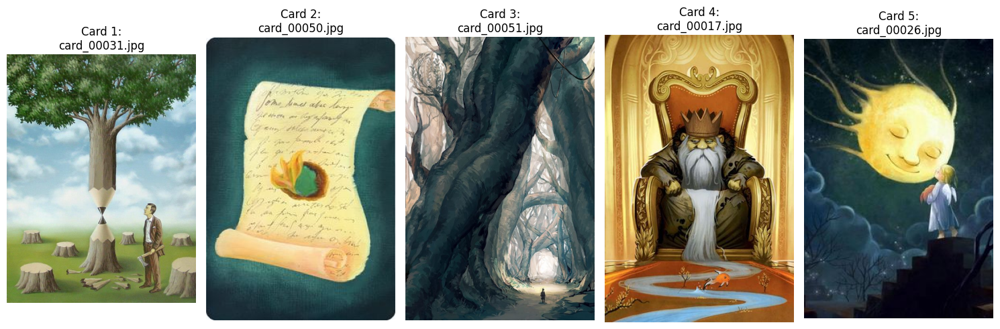

In [ ]:
# Round 8
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(8)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 51)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:dark paths brought you here
Mmmh... let me see...
My guess is: /content/cards/card_00051.jpg.
Am I correct (y/n)?y
YU-HUUUU! This is one point for me!


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



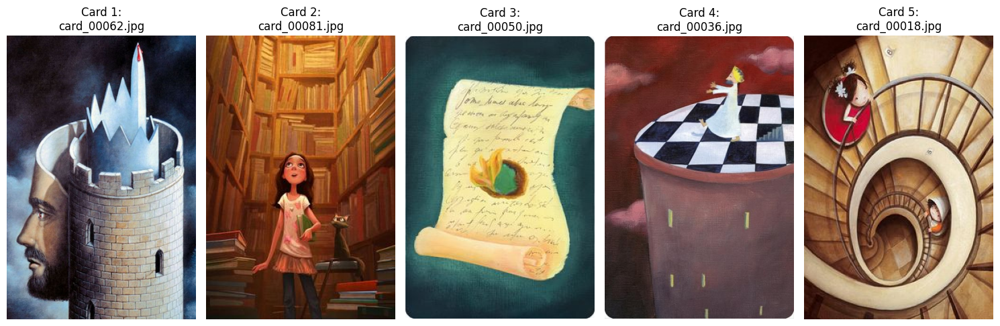

In [ ]:
# Round 9
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(9)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 62)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:entwined mindpaths
Mmmh... let me see...
My guess is: /content/cards/card_00050.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



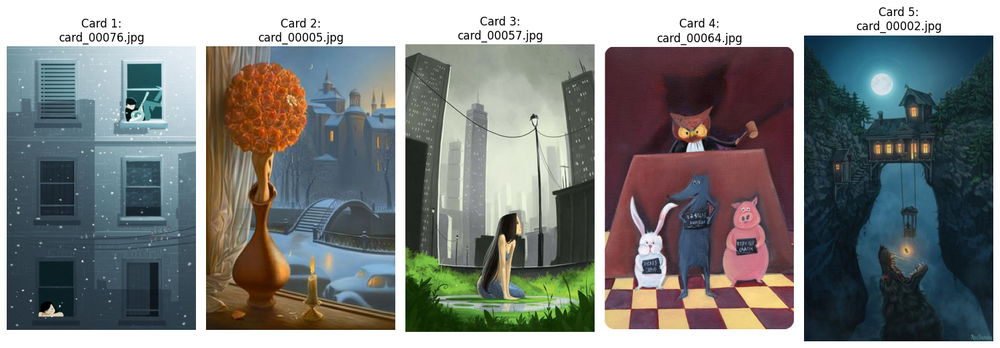

In [ ]:
# Round 10
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(10)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 5)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:inner warmth
Mmmh... let me see...
My guess is: /content/cards/card_00002.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



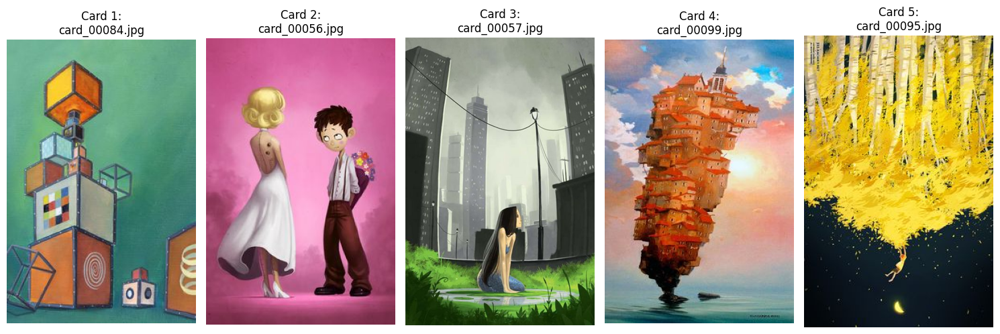

In [ ]:
# Extra round 11
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(38)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 57)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:solitude
Mmmh... let me see...
My guess is: /content/cards/card_00095.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



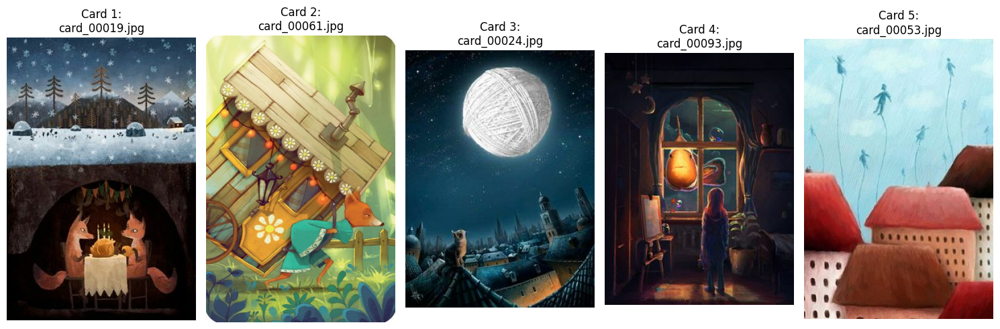

In [ ]:
# Extra round 12
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(100)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 24)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:dream big
Mmmh... let me see...
My guess is: /content/cards/card_00093.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



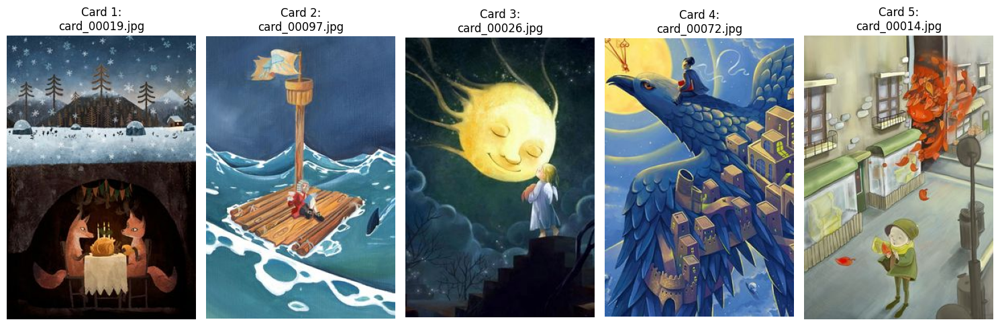

In [ ]:
# Extra round 13
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(87)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:so close Icarus got burnt
Mmmh... let me see...
My guess is: /content/cards/card_00014.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



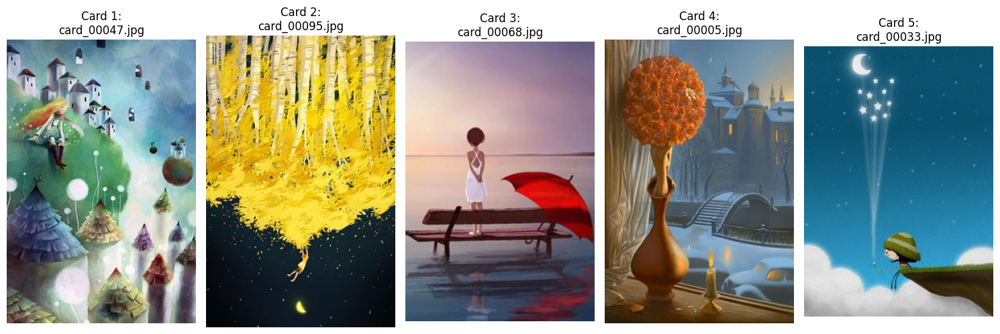

In [ ]:
# Extra round 14
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(235)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?")  # (it was card 68)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:demon slayer
Mmmh... let me see...
My guess is: /content/cards/card_00095.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


---

I'll be the Guesser for this round!

This is your hand of cards. I won't look, I promise!



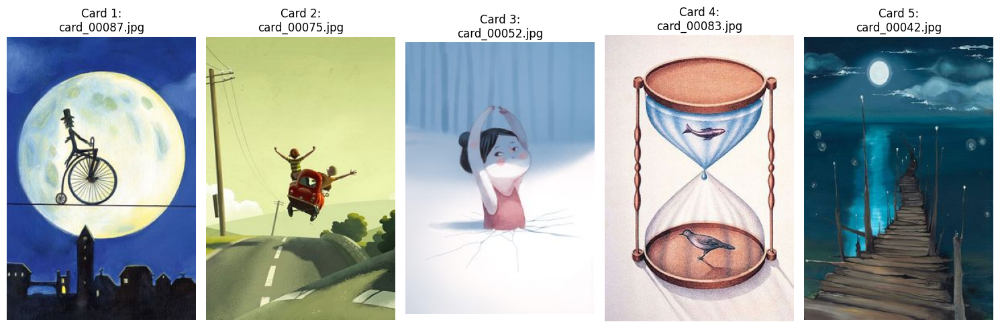

In [ ]:
# Extra round 15
print("I'll be the Guesser for this round!\n")
print("This is your hand of cards. I won't look, I promise!\n")

random.seed(654)
cards_hand = random.sample(cards_folder, 5)
plot_hand_of_cards(cards_hand)

In [ ]:
user_clue = input("Please, choose an image and tell me your clue:")

print("Mmmh... let me see...")
guess = guesser_routine(user_clue, cards_hand)
print(f"My guess is: {guess}.")

user_answer = input("Am I correct (y/n)?") # (it was card 83)

if user_answer == 'y':
    print("YU-HUUUU! This is one point for me!")
else:
    print("Oh, no. Let's play again.")

Please, choose an image and tell me your clue:my last close friend
Mmmh... let me see...
My guess is: /content/cards/card_00075.jpg.
Am I correct (y/n)?n
Oh, no. Let's play again.


## 8) Evaluating performance

We have conducted experiments to compare the bot's performance both as a storyteller and as a guesser against GPT-4o multimodal and humans in $15$ games for each role. The performance evaluation follows.

### Storyteller performance

We measure Storyteller's effectiveness via an inverse measure of the players' accuracy. The players we tested the agent agains are $(1)$ Human and $(2)$ GPT-4o via the ChatGPT interface. To quantify how good our model is as a storyteller, we take the complementary of these players' accuracies: `(1 - player_accuracy)`. The optimal value for a metric of effectiveness in the specific Dixit case is $50\%$ ($0\%$ is the case where the players always guess right, so the clue is too easy, and $100\%$ is the case where the players always lose, so the clue is too difficult). <br>
These players accuracy was:

$$
(1)\quad \text{Human Accuracy} = \frac{\text{Number of correct guesses}}{\text{Number of total guesses}} = \frac{11}{15} = 0.73 = 73\% \\
\text{Storyteller Effectiveness vs. Human} = (1 - \text{Human Accuracy}) = 1 - 0.73 = 0.27 = 27\% \\
$$

$$
(2)\quad \text{GPT-4o Accuracy} = \frac{\text{Number of correct guesses}}{\text{Number of total guesses}} = \frac{14}{15} = 0.93 = 93\% \\
\text{Storyteller Effectiveness vs. GPT-4o} = (1 - \text{GPT-4o Accuracy}) = 1 - 0.93 = 0.07 = 7\% \\
$$

### Guesser performance

Here, we can directly measure the accuracy of our model as a guesser based on the input clue coming from itself (i.e., we tried to feed the clues and the hand of cards of the storyteller back to the guesser to see if it it was able to backtrack the original image) and from a human. Unfortunately, it was not feasible to test it against GPT-4o because of the very restricted multimodal functionalities of the model allowed for users of the free subscription plan at the moment.

$$
(1) \quad \text{Guesser Accuracy vs. Itself} = \frac{\text{Number of correct guesses}}{\text{Number of total guesses}} = \frac{9}{15} = 0.6 = 60\%
$$

$$
(2)\quad \text{Guesser Accuracy vs. Human} = \frac{\text{Number of correct guesses}}{\text{Number of total guesses}} = \frac{3}{15} = 0.2  = 20\%
$$

## 9) Limitations and potential improvements

The agent is simply not "good" enough. Neither as the storyteller, because the clue is still too easy, nor as the guesser, because the human capability of making associations and understanding abstractions is just too much higher.<br>
That said, there is a lot of room for improvement, starting from refining the text corpus to experiment with different LLM prompts to making the whole process of clue generation more complex, involving also other models etc. <br>
Below a list of ideas that didn't get the time to be explored properly:
- Furtherly refine the text corpus, possibly integrating/replacing it with an LLM-generated list of keywords related to Dixit;
- Explore the possibility of web scraping to gather specific sets of words;
- Spend more time on prompt engineering to understand the best way to instruct the LLM for our task;
- Try different LLMs to compare performances;
- Try different CLIP-like models to compare performances;
- Try another strategy for caption generation throwing segmentation models in the mix;
- Create an API tool to experiment with the agent in an environment which is more visual appealing and user friendly;
- Implement a more realistic game dynamics tracking scores.

I personally liked the idea of this project and if I have the time I will try to follow some of these cues.

## 10) Other ideas

Another direction of work which, didn't get the time to be explored properly, is using models trained *directly* for the image caption generation task next to the LLM and make them contribute together to the final clue. For example, they could be used:
- <u>In pipeline</u>: take the output of an image captioning model and incorporate it into the LLM's storyteller prompt. Seeing together the keywords and the caption, the LLM could get a much clearer idea of the card's content and output better candidate clues;
- <u>In parallel</u>: take the candidate captions from the LLM, the image caption from the generative model, and pass them all again to CLIP to choose the one with the best similarity. A potential drawback here is that the model-generated caption is expected to be much more literal than the LLM-generated one, as not all models might be explicitly instructed to "be creative". But there is room for experimenting.

A Language-Image Pre-Trained model specifically trained for image caption generation is **BLIP (Bootstrapping Language-Image Pre-training)**. Below, we load the model and run a simple test on one of the Dixit images to see its capabilities.

***P.S. :*** actually, BLIP allows to input an optional prompt for the model to complete. It would be interesting to try creative prompts, like "this image is a metaphor for ...", "this image symbolically represents ..."

In [ ]:
import torch
import requests
from PIL import Image
from transformers import AutoProcessor, Blip2ForConditionalGeneration

processor = AutoProcessor.from_pretrained("Salesforce/blip2-opt-2.7b")
# by default `from_pretrained` loads the weights in float32
# we load in float16 instead to save memory
model = Blip2ForConditionalGeneration.from_pretrained("Salesforce/blip2-opt-2.7b", torch_dtype=torch.float16)

processor_config.json:   0%|          | 0.00/68.0 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/432 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/882 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/3.56M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/23.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.03k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/122k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/10.0G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.98G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/141 [00:00<?, ?B/s]

In [ ]:
%%capture
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

Image captioning with BLIP-2 and a sample Dixit image


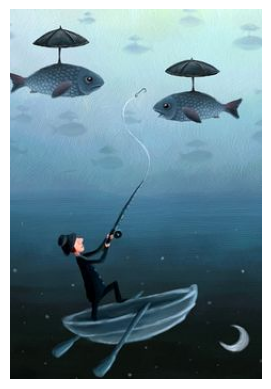

a man in a boat with fish under umbrellas


In [ ]:
image = Image.open("/content/card_00098.jpg").convert('RGB')

show_card("/content/card_00098.jpg")

inputs = processor(image, return_tensors="pt").to(device, torch.float16)

generated_ids = model.generate(**inputs, max_new_tokens = 20)
generated_text = processor.batch_decode(generated_ids, skip_special_tokens = True)[0].strip()

print("BLIP description:")
print(generated_text)

Prompted image captioning with BLIP-2 and sample image

In [ ]:
prompt = "a dreamer's clue for this image is" # experiment different prompts

inputs = processor(image, text=prompt, return_tensors="pt").to(device, torch.float16)

generated_ids = model.generate(**inputs, max_new_tokens=20)
generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0].strip()
print(generated_text)

a dreamer's clue for this image is that the fish are flying in the air and the man is fishing


---

## 11) References

A list of the main literary references used in this project is reported below.

Main reference:

- Kunda, M., & Rabkina, I. (2020). Creative Captioning: An AI Grand Challenge Based on the Dixit Board Game. arXiv preprint arXiv:2010.00048.
[Link](https://arxiv.org/abs/2010.00048)

CLIP and Clip-like models:

- **CLIP**: Radford, A., Kim, J. W., Hallacy, C., Ramesh, A., Goh, G., Agarwal, S., ... & Sutskever, I. (2021, July). Learning transferable visual models from natural language supervision. In International conference on machine learning (pp. 8748-8763). PMLR. [Link](https://arxiv.org/abs/2103.00020)

- **EVA CLIP**: improves on CLIP performances with same numer of parameters but smaller training costs https://arxiv.org/abs/2303.15389

<img src="https://raw.githubusercontent.com/baaivision/EVA/refs/heads/master/EVA-CLIP/assets/teaser.png" width = 600 />

- **SigLIP**: sigmoid loss allows to have a smaller model but better performances, outperforms both CLIP and EVA CLIP https://arxiv.org/abs/2303.15343 https://huggingface.co/docs/transformers/model_doc/siglip https://medium.com/@jiangmen28/siglip-vs-clip-the-sigmoid-advantage-457f1cb872ab

<img src="https://cdn-lfs.hf.co/datasets/huggingface/documentation-images/f9a71ee14747cc69cf6bdf517ab77b262ab502e14adaba22548afe10ddbb4706?response-content-disposition=inline%3B+filename*%3DUTF-8%27%27siglip_table.jpeg%3B+filename%3D%22siglip_table.jpeg%22%3B&response-content-type=image%2Fjpeg&Expires=1737284806&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQVdTOkVwb2NoVGltZSI6MTczNzI4NDgwNn19LCJSZXNvdXJjZSI6Imh0dHBzOi8vY2RuLWxmcy5oZi5jby9kYXRhc2V0cy9odWdnaW5nZmFjZS9kb2N1bWVudGF0aW9uLWltYWdlcy9mOWE3MWVlMTQ3NDdjYzY5Y2Y2YmRmNTE3YWI3N2IyNjJhYjUwMmUxNGFkYWJhMjI1NDhhZmUxMGRkYmI0NzA2P3Jlc3BvbnNlLWNvbnRlbnQtZGlzcG9zaXRpb249KiZyZXNwb25zZS1jb250ZW50LXR5cGU9KiJ9XX0_&Signature=NPZ9dbbojxJNdGPqJKtdebb9NKSQnH8moPZ8PlvSSRRKxM-C54C%7EgtomwTCCGnUDIECL3CQ9F8oKFcD6tg-FuXtIImoxxU3m7r-jzu8FfxaT7lBuv4tzCX7EU9K1yHUjjxMMxbXfi0twXdRGIjcJT8N%7E8PfuR6btqabx0RloXnMDGIAbkBncy9jWuIXjO5tGEW5khTGuZEMwoOqzuU-OQhqcDiV%7E97UrO5E5Redd-JEXlXsmXpB7p9EyFPlaIQYrAM8csurawDO2gIqT6OwTguO5t7XyfUencAjFsqwx%7E8V87Cm%7EdavPRyvLSZds%7E5H4Ldf73L-hTlf%7Ew2YjrIBjAA__&Key-Pair-Id=K3RPWS32NSSJCE" width = 700/>

https://medium.com/@jiangmen28/siglip-vs-clip-the-sigmoid-advantage-457f1cb872ab

https://ritvik19.medium.com/papers-explained-152-siglip-011c48f9d448

- **LLM2CLIP**: Wu, A., Yang, Y., Luo, X., Yang, Y., Wang, C., Hu, L., ... & Qiu, L. LLM2CLIP: Powerful Language Model Unlock Richer Visual Representation. In NeurIPS 2024 Workshop: Self-Supervised Learning-Theory and Practice. [Link](https://arxiv.org/html/2411.04997v3) <br>
Introduction of a fine-tuning approach that integrates LLMs with the pretrained CLIP visual encoder, to make CLIP able to process longer and more complex prompts

- **PaliGEMMA**: pen Vision-Language Model (VLM) that is based on the SigLIP-So400m vision encoder and the Gemma-2B language model. https://arxiv.org/abs/2407.07726 https://huggingface.co/blog/paligemma



BLIP models:

- Li, J., Li, D., Xiong, C., & Hoi, S. (2022, June). Blip: Bootstrapping language-image pre-training for unified vision-language understanding and generation. In International conference on machine learning (pp. 12888-12900). PMLR. [Link](https://arxiv.org/abs/2201.12086)

- Li, J., Li, D., Savarese, S., & Hoi, S. (2023, July). Blip-2: Bootstrapping language-image pre-training with frozen image encoders and large language models. In International conference on machine learning (pp. 19730-19742). PMLR. [Link](https://arxiv.org/abs/2301.12597)